# Guide
### for DeepCID
#### data load (pos + neg) -> preprocessing (baseline remove...) -> oversampling and integration -> data blending -> blended data seperation

In [13]:
import numpy as np
from numpy import genfromtxt
from matplotlib import pyplot as plt 
import random
import os
import pandas as pd
import pybaselines
from pybaselines import utils
from data_preprocessing import raman_shift_matching
from imblearn.over_sampling import SMOTE, ADASYN
from collections import Counter
import fnmatch
from renishawWiRE import WDFReader
from sklearn.preprocessing import normalize


In [2]:
def avg(x,cls,cnt,shift):
    x_avg = np.zeros(shift)
    for i in range(cnt):
        x_avg = x[i+cls*cnt] + x_avg
    x_avg = x_avg/cnt
    return x_avg

In [3]:
def avg_range(x,a,b,shift):
    x_avg = np.zeros(shift)
    for i in range(b-a+1):
        x_avg = x[i+a] + x_avg
    x_avg = x_avg/(b-a+1)
    return x_avg

In [4]:
def std(x,avg,cls,cnt,shift,scale=1):
    x_std = np.zeros(shift)
    for i in range(cnt):
        for j in range(shift):
            x_std[j] += pow(x[i+cls*cnt][j] - avg[j],2)
    x_std = np.sqrt(x_std)/scale
    return x_std

In [5]:
def std_range(x,avg,a,b,shift,scale=1):
    x_std = np.zeros(shift)
    for i in range(b-a+1):
        for j in range(shift):
            x_std[j] += pow(x[a+i][j] - avg[j],2)
    x_std = np.sqrt(x_std)/scale
    return x_std

In [6]:
def min_max_normalize(arr):
    norm_arr = []
    arr = arr - min(arr)
    diff_arr = max(arr) - min(arr)    
    for i in arr:
        temp = ((i - min(arr))/diff_arr)
        norm_arr.append(temp)
    return norm_arr

In [7]:
def z_normalize(arr):
    norm_arr = []  
    for i in arr:
        temp = ((i - np.mean(arr))/np.std(arr))
        norm_arr.append(temp)
    return norm_arr

In [8]:
def postprocessing(dataset):
    output = []
    for i in range(dataset.shape[0]):
        tmp = spikes_removal(dataset[i],6,3)
        
        baseline, _ = pybaselines.whittaker.airpls(dataset[i]) 
        #baseline, _ = pybaselines.whittaker.psalsa(dataset[i])
        tmp = tmp-baseline     
   
        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        
        tmp = min_max_normalize(tmp)
        
        output.append(tmp)
    return np.array(output)

In [9]:
def modified_z_score(intensity):
    median_int = np.median(intensity)
    mad_int = np.median([np.abs(intensity - median_int)])
    modified_z_scores = 0.6745 * (intensity - median_int) / mad_int
    return modified_z_scores

def fixer(y,m,threshold):
    spikes = abs(np.array(modified_z_score(np.diff(y)))) > threshold
    y_out = y.copy() # So we don’t overwrite y
    #print(np.where(spikes==True))
    #if np.where(spikes==True)[0].shape[0]!=0 :
        #print(np.where(spikes==True))
    for i in np.arange(len(spikes)):
        if spikes[i] != 0: # If we have an spike in position i
            #print(y_out[i],end=' ')
            #print(y_out[i-m:i+1+m])
            w = np.arange(i-m,i+1+m) # we select 2 m + 1 points around our spike
            w = np.where(w>=y_out.shape[0]-1,y_out.shape[0]-2,w)
            #print(w)
            w2 = w[spikes[w] == 0] # From such interval, we choose the ones which are not spikes
            #print(w2)
            y_out[i] = np.mean(y[w2]) # and we average their values
            if np.isnan(y_out[i]):
                #print(i)
                #print(w)
                y_out[i]=y[i]
                
            #print(y_out[i-m:i+1+m])
            #print(y_out[i + 1],end=' ')
    return y_out

In [10]:
def boxcar(data, kernel_size=3):
    kernel = np.ones(kernel_size) / kernel_size
    ret = np.zeros(data.size)
    for i in range(data.size):
        for j in range(kernel_size):
            ret[i] += (
                kernel[j] * data[np.min([np.max([i + j - int(kernel_size / 2), 0]), data.size - 1])]
            )
            # print(np.max([i+j-int(kernel_size/2), 0]))
    return ret

In [11]:
def spikes_removal(intensity,threshold,m):
    dist = 0
    delta_intensity = [] 
    delta_int = np.diff(intensity)
    intensity_modified_z_score = np.array(np.abs(modified_z_score(delta_int)))
    return fixer(intensity,m=3,threshold=threshold)
    

# bacteria-ID data load

In [12]:
wavenum = np.load('/home/jeonggyu/workspace/data/bacteria-ID/data/wavenumbers.npy')

x_ref = np.load('/home/jeonggyu/workspace/data/bacteria-ID/data/X_reference.npy')
y_ref = np.load('/home/jeonggyu/workspace/data/bacteria-ID/data/y_reference.npy')

auged_dataset = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/bacteria-id/auged_dataset.npy')
auged_dataset_neg = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/bacteria-id/auged_dataset_neg.npy')
auged_labelset = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/bacteria-id/auged_labelset.npy')
auged_labelset_neg = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/bacteria-id/auged_labelset_neg.npy')  


data_list = [x_ref,auged_dataset,auged_dataset_neg]
label_list = [y_ref,auged_labelset,auged_labelset_neg]

x_list = []
y_list = []
for i in range(len(data_list)):
    tmp = data_list[i]
    tmp = np.reshape(tmp,(tmp.shape[0],1000))
    x_list.append(tmp)


# SKKU data load

In [13]:

skku_train_pos=[]
skku_train_neg=[]

for i in range(170):
    data1 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"0-40s(spot170)_E-coli+PBS/10^8 E. coli - Integration time 40s - 5s - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data2 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"160-200s(spot170)_E-coli+PBS/10^8 E. coli - Integration time 40s - 200s - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data3 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"80-120s(spot170)_E-coli+PBS/10^8 E. coli - Integration time 40s - 100s - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data1 = data1.iloc[1:1025,1:].to_numpy().astype(np.float64)
    data2 = data2.iloc[1:1025,1:].to_numpy().astype(np.float64)
    data3 = data3.iloc[1:1025,1:].to_numpy().astype(np.float64)
    skku_train_pos.append(data1)
    skku_train_pos.append(data2)
    skku_train_pos.append(data3)
    
for i in range(19):
    data1 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"E-coli+IgG+PBS(spot19)/(NP X) - IgG 10 mgml, 10^6 E-coli - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data2 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"E-coli+PBS(spot19)/(NP X) - 10^6 E-coli - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data3 = pd.read_csv("/home/jeonggyu/workspace/data/skku/skku/raw/"\
                        +"IgG+PBS(spot19)/(NP X) IgG - spot "\
                        +str(i+1)+".txt",sep="\t",engine='python')
    data1 = data1.iloc[1:1025,1:].to_numpy().astype(np.float64)
    data2 = data2.iloc[1:1025,1:].to_numpy().astype(np.float64)
    data3 = data3.iloc[1:1025,1:].to_numpy().astype(np.float64)
    skku_train_pos.append(data1)
    skku_train_pos.append(data2)
    skku_train_neg.append(data3)
    
skku_train_pos = np.array(skku_train_pos)
skku_train_neg = np.array(skku_train_neg)
skku_train_pos = np.reshape(skku_train_pos,(skku_train_pos.shape[0],skku_train_pos.shape[1]))
skku_train_neg = np.reshape(skku_train_neg,(skku_train_neg.shape[0],skku_train_neg.shape[1]))
    
skku_labelset_pos=np.ones((skku_train_pos.shape[0],1))
skku_labelset_neg=np.zeros((skku_train_neg.shape[0],1))

skku_train_dataset = np.concatenate((skku_train_pos,skku_train_neg),axis=0)
skku_train_labelset = np.concatenate((skku_labelset_pos,skku_labelset_neg),axis=0)
skku_train_labelset = np.reshape(skku_train_labelset,(skku_train_labelset.shape[0]))


skku=[]
for i in range(100):
    data = pd.read_csv("/home/jeonggyu/workspace/data/skku/Raman - 80 % E. coli - 10 mW (spot 100)"\
                        +"/Raman - 80 % E. coli - 10 mW - spot "+str(i+1)+".txt",sep="\t",engine='python')
    if i == 0:
        wavenum_skku = data.iloc[1:1025,0].to_numpy().astype(np.float64)
    data = data.iloc[1:1025,1:].to_numpy().astype(np.float64)
    skku.append(data)
skku = np.array(skku)
skku = np.reshape(skku,(skku.shape[0],skku.shape[1]))


data_list.append(skku)
data_list.append(skku_train_dataset)
label_list.append(None)
label_list.append(skku_train_labelset)

x_list.append(skku)
x_list.append(skku_train_dataset)


# Ramcell data load (e-coli, SA)

In [69]:
ramcell_path = "/home/jeonggyu/workspace/data/ramcell"
wavenum_size = 1015

In [70]:
ramcell_ecoli_wavenum = []
ramcell_ecoli_dataset=[]
loaded_ecoli_files =[]
ecoli_path = ramcell_path+"/Ecoli_1207/G/"
#ecoli_path = ramcell_path+"/Ecoli_1021/"
#ecoli_path = ramcell_path+"/Ecoli/Export_based/"

for file_name in os.listdir(ecoli_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_ecoli_files.append(file_name)
        reader = WDFReader(ecoli_path+file_name)
        if len(ramcell_ecoli_wavenum)==0:
            ramcell_ecoli_wavenum = np.array(reader.xdata)
        ramcell_ecoli_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_ecoli_files.append(file_name)
        data = pd.read_csv(ecoli_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_ecoli_wavenum)==0:
            ramcell_ecoli_wavenum = data.iloc[:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_ecoli_dataset.append(data)
        
ramcell_ecoli_dataset = np.array(ramcell_ecoli_dataset)
print(ramcell_ecoli_dataset.shape)


(3600, 1015)


In [24]:
ramcell_SA_wavenum = []
ramcell_SA_dataset=[]
loaded_SA_files =[]

#SA_path = ramcell_path+"/SA_1021/"
SA_path = ramcell_path+"/SA/EX_SA_b/"
for file_name in os.listdir(SA_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_SA_files.append(file_name)
        reader = WDFReader(SA_path+file_name)
        if len(ramcell_SA_wavenum)==0:
            ramcell_SA_wavenum = np.array(reader.xdata)
        ramcell_SA_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_SA_files.append(file_name)
        data = pd.read_csv(SA_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_SA_wavenum)==0:
            ramcell_SA_wavenum = data.iloc[0:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_SA_dataset.append(data)
        
ramcell_SA_dataset = np.array(ramcell_SA_dataset)
print(ramcell_SA_dataset.shape)


(224, 1015)


# Search

In [82]:
index = np.array([4, 7, 8, 9, 11, 14, 18, 21, 25, 28, 29, 31, 32, 37, 38, 42, 45, 50, 53, 61, 62, 65, 68, 71, 72, 73, 77, 78, 79, 80, 82, 85, 86, 88, 89, 91, 92, 96, 100, 101, 103, 108, 111, 113, 115, 117, 119, 120, 121, 122, 123, 127, 129, 132, 133, 135, 137, 138, 145, 147, 148, 151, 157, 160, 162, 163, 169, 170, 174, 175, 176, 177, 179, 180, 182, 183, 184, 185, 186, 187, 188, 192, 193, 197, 199, 202, 203, 205, 206, 209, 210, 211, 212, 215, 216, 218, 219, 220, 221, 222, 225, 227, 229, 230, 235, 236, 239, 240, 241, 243, 244, 245, 252, 253, 255, 259, 261, 262, 263, 265, 266, 267, 269, 272, 273, 275, 277, 278, 282, 283, 284, 285, 286, 287, 290, 295, 297, 303, 305, 310, 311, 312, 314, 315, 319, 320, 322, 324, 326, 328, 333, 334, 343, 345, 348, 350, 355, 356, 364, 366, 368, 369, 371, 372, 374, 375, 376, 377, 380, 383, 386, 392, 394, 395, 397, 403, 404, 406, 408, 409, 411, 412, 413, 414, 415, 418, 419, 421, 423, 424, 425, 428, 429, 435, 439, 441, 442, 452, 459, 463, 464, 465, 466, 468, 475, 476, 478, 479, 480, 489, 490, 491, 496, 501, 503, 509, 512, 513, 515, 518, 519, 523, 525, 529, 532, 534, 535, 539, 541, 544, 545, 546, 548, 549, 553, 554, 558, 559, 560, 567, 569, 572, 575, 578, 579, 580, 581, 586, 587, 588, 595, 597, 598, 600, 602, 606, 615, 618, 621, 624, 627, 630, 633, 636, 637, 638, 639, 640, 645, 646, 648, 649, 653, 654, 656, 658, 659, 662, 663, 667, 670, 671, 673, 675, 676, 683, 689, 691, 694, 695, 697, 702, 703, 705, 710, 711, 714, 715, 721, 727, 729, 733, 740, 741, 742, 745, 746, 747, 752, 757, 758, 759, 762, 763, 764, 765, 766, 770, 772, 773, 774, 781, 784, 786, 790, 791, 792, 797, 799, 803, 805, 808, 809, 810, 811, 814, 823, 830, 832, 833, 834, 836, 847, 856, 857, 858, 859, 860, 862, 863, 865, 866, 868, 869, 870, 872, 873, 874, 876, 879, 881, 883, 884, 885, 896, 900, 901, 904, 905, 906, 908, 909, 910, 912, 914, 915, 917, 920, 923, 924, 926, 928, 930, 931, 934, 938, 939, 940, 945, 947, 950, 951, 953, 955, 956, 958, 960, 966, 971, 975, 976, 981, 983, 988, 989, 990, 991, 993, 998, 999, 1000, 1002, 1003, 1006, 1007, 1008, 1010, 1012, 1013, 1014, 1016, 1018, 1022, 1024, 1026, 1028, 1029, 1030, 1032, 1040, 1041, 1045, 1047, 1049, 1051, 1052, 1055, 1056, 1058, 1060, 1061, 1062, 1063, 1064, 1065, 1066, 1069, 1073, 1081, 1088, 1091, 1092, 1093, 1094, 1095, 1097, 1098, 1099, 1102, 1117, 1118, 1120, 1121, 1125, 1126, 1128, 1131, 1132, 1133, 1136, 1138, 1139, 1140, 1142, 1144, 1146, 1147, 1149, 1153, 1156, 1157, 1159, 1160, 1162, 1163, 1168, 1176, 1177, 1178, 1180, 1181, 1182, 1186, 1187, 1189, 1192, 1197, 1198, 1202, 1203, 1205, 1206, 1207, 1214, 1215, 1216, 1219, 1220, 1222, 1223, 1225, 1226, 1227, 1228, 1229, 1230, 1234, 1237, 1238, 1239, 1240, 1244, 1245, 1246, 1247, 1248, 1249, 1252, 1253, 1254, 1255, 1257, 1264, 1266, 1268, 1269, 1271, 1272, 1278, 1279, 1281, 1285, 1286, 1287, 1289, 1294, 1295, 1296, 1301, 1303, 1307, 1321, 1322, 1324, 1326, 1334, 1336, 1338, 1343, 1347, 1351, 1352, 1354, 1360, 1363, 1365, 1368, 1371, 1372, 1373, 1374, 1377, 1381, 1383, 1391, 1392, 1393, 1394, 1408, 1410, 1411, 1412, 1413, 1415, 1419, 1420, 1422, 1423, 1425, 1426, 1427, 1428, 1430, 1432, 1434, 1436, 1439, 1441, 1442, 1443, 1445, 1447, 1448, 1449, 1450, 1451, 1452, 1453, 1454, 1455, 1457, 1459, 1462, 1465, 1467, 1469, 1470, 1474, 1477, 1479, 1482, 1483, 1485, 1489, 1490, 1491, 1492, 1494, 1495, 1496, 1499, 1500, 1501, 1507, 1513, 1514, 1515, 1517, 1519, 1521, 1522, 1523, 1524, 1525, 1527, 1528, 1531, 1532, 1533, 1536, 1538, 1541, 1543, 1545, 1546, 1547, 1549, 1550, 1553, 1555, 1556, 1557, 1561, 1562, 1563, 1564, 1566, 1568, 1570, 1571, 1572, 1573, 1577, 1578, 1579, 1583, 1585, 1586, 1590, 1591, 1592, 1596, 1597, 1598, 1599, 1608, 1609, 1610, 1611, 1612, 1618, 1619, 1621, 1624, 1630, 1636, 1637, 1638, 1641, 1644, 1649, 1651, 1652, 1656, 1659, 1661, 1665, 1667, 1672, 1675, 1677, 1678, 1680, 1682, 1683, 1686, 1688, 1689, 1690, 1691, 1692, 1693, 1694, 1696, 1703, 1708, 1709, 1716, 1719, 1720, 1721, 1723, 1730, 1732, 1736, 1737, 1739, 1742, 1744, 1745, 1754, 1757, 1759, 1763, 1766, 1767, 1768, 1770, 1771, 1774, 1775, 1776, 1778, 1779, 1780, 1783, 1786, 1788, 1792, 1793, 1797, 1798, 1799, 1803, 1804, 1806, 1807, 1808, 1809, 1811, 1812, 1814, 1816, 1819, 1820, 1822, 1823, 1825, 1827, 1828, 1829, 1839, 1840, 1844, 1845, 1846, 1849, 1850, 1851, 1852, 1853, 1858, 1860, 1862, 1864, 1870, 1872, 1876, 1881, 1882, 1883, 1884, 1887, 1889, 1890, 1893, 1897, 1900, 1901, 1905, 1906, 1907, 1908, 1909, 1910, 1915, 1916, 1917, 1918, 1923, 1926, 1933, 1935, 1936, 1937, 1939, 1941, 1942, 1943, 1945, 1946, 1950, 1955, 1959, 1961, 1962, 1964, 1965, 1967, 1968, 1977, 1979, 1980, 1982, 1986, 1987, 1988, 1994, 1995, 1997, 2000, 2001, 2002, 2003, 2004, 2009, 2012, 2014, 2016, 2017, 2020, 2023, 2025, 2027, 2029, 2030, 2031, 2032, 2034, 2039, 2040, 2042, 2044, 2046, 2050, 2051, 2052, 2053, 2055, 2059, 2063, 2065, 2068, 2070, 2071, 2074, 2075, 2081, 2086, 2087, 2088, 2090, 2096, 2097, 2105, 2106, 2107, 2108, 2109, 2113, 2115, 2117, 2118, 2120, 2123, 2124, 2125, 2129, 2130, 2136, 2137, 2142, 2144, 2146, 2147, 2149, 2151, 2152, 2155, 2156, 2157, 2159, 2161, 2162, 2169, 2172, 2174, 2176, 2177, 2180, 2181, 2182, 2183, 2184, 2186, 2187, 2189, 2190, 2192, 2193, 2195, 2196, 2198, 2199, 2201, 2202, 2208, 2209, 2211, 2213, 2214, 2216, 2219, 2221, 2224, 2225, 2229, 2230, 2231, 2233, 2234, 2236, 2238, 2239, 2242, 2244, 2245, 2246, 2247, 2250, 2251, 2252, 2253, 2254, 2259, 2260, 2268, 2270, 2271, 2272, 2273, 2275, 2276, 2277, 2280, 2282, 2283, 2286, 2294, 2300, 2301, 2305, 2306, 2307, 2312, 2315, 2317, 2318, 2321, 2324, 2327, 2328, 2329, 2330, 2331, 2332, 2337, 2339, 2340, 2348, 2349, 2352, 2355, 2356, 2358, 2359, 2363, 2366, 2367, 2370, 2371, 2373, 2378, 2380, 2381, 2382, 2384, 2386, 2387, 2388, 2391, 2393, 2395, 2400, 2401, 2403, 2404, 2405, 2407, 2408, 2411, 2412, 2413, 2414, 2416, 2417, 2420, 2421, 2425, 2427, 2434, 2435, 2438, 2442, 2446, 2447, 2448, 2450, 2451, 2452, 2453, 2454, 2455, 2456, 2458, 2459, 2464, 2465, 2468, 2471, 2473, 2477, 2481, 2482, 2484, 2485, 2486, 2490, 2491, 2492, 2502, 2504, 2505, 2509, 2510, 2511, 2515, 2520, 2521, 2522, 2524, 2525, 2527, 2529, 2535, 2536, 2538, 2540, 2543, 2544, 2548, 2549, 2552, 2553, 2558, 2561, 2564, 2565, 2566, 2568, 2570, 2572, 2574, 2576, 2578, 2579, 2581, 2585, 2589, 2591, 2592, 2594, 2595, 2597, 2598, 2602, 2603, 2604, 2610, 2613, 2615, 2617, 2622, 2623, 2628, 2630, 2632, 2636, 2637, 2638, 2643, 2644, 2646, 2647, 2652, 2656, 2657, 2658, 2660, 2662, 2665, 2666, 2667, 2671, 2673, 2676, 2677, 2684, 2687, 2688, 2689, 2690, 2692, 2694, 2699, 2703, 2720, 2721, 2722, 2725, 2728, 2730, 2731, 2735, 2736, 2739, 2740, 2744, 2746, 2748, 2749, 2757, 2758, 2761, 2765, 2768, 2771, 2772, 2777, 2778, 2780, 2785, 2790, 2796, 2797, 2799, 2802, 2805, 2810, 2811, 2814, 2815, 2821, 2822, 2824, 2826, 2829, 2832, 2834, 2835, 2837, 2839, 2841, 2843, 2845, 2846, 2848, 2849, 2852, 2856, 2859, 2863, 2864, 2865, 2867, 2868, 2873, 2874, 2875, 2876, 2877, 2879, 2883, 2884, 2885, 2893, 2896, 2902, 2904, 2905, 2906, 2910, 2912, 2913, 2915, 2918, 2919, 2920, 2924, 2925, 2926, 2928, 2932, 2936, 2937, 2940, 2941, 2943, 2945, 2948, 2953, 2958, 2959, 2960, 2962, 2965, 2968, 2974, 2975, 2976, 2981, 2983, 2986, 2987, 2988, 2989, 2994, 2999, 3000, 3003, 3004, 3007, 3009, 3011, 3012, 3014, 3019, 3024, 3025, 3026, 3027, 3028, 3029, 3031, 3033, 3034, 3035, 3036, 3037, 3040, 3041, 3044, 3046, 3052, 3058, 3060, 3062, 3065, 3067, 3068, 3069, 3070, 3073, 3075, 3077, 3082, 3085, 3088, 3089, 3093, 3094, 3096, 3098, 3102, 3105, 3109, 3111, 3115, 3118, 3119, 3120, 3122, 3126, 3127, 3130, 3135, 3136, 3137, 3138, 3139, 3141, 3143, 3154, 3158, 3160, 3161, 3164, 3165, 3166, 3167, 3169, 3172, 3174, 3180, 3187, 3188, 3190, 3192, 3193, 3194, 3195, 3197, 3199, 3203, 3208, 3210, 3213, 3216, 3218, 3219, 3224, 3225, 3229, 3231, 3232, 3234, 3236, 3238, 3241, 3243, 3244, 3245, 3253, 3257, 3262, 3265, 3268, 3269, 3270, 3275, 3277, 3279, 3282, 3288, 3290, 3294, 3298, 3300, 3303, 3304, 3307, 3310, 3311, 3312, 3313, 3314, 3319, 3321, 3322, 3325, 3326, 3327, 3328, 3331, 3332, 3334, 3336, 3338, 3339, 3344, 3350, 3357, 3358, 3359, 3360, 3361, 3367, 3368, 3369, 3374, 3378, 3380, 3381, 3384, 3385, 3387, 3388, 3390, 3392, 3393, 3396, 3397, 3398, 3399, 3402, 3404, 3405, 3408, 3410, 3411, 3412, 3415, 3416, 3418, 3422, 3425, 3426, 3428, 3429, 3432, 3433, 3435, 3438, 3443, 3446, 3447, 3450, 3451, 3452, 3453, 3454, 3456, 3458, 3460, 3461, 3462, 3468, 3469, 3477, 3479, 3483, 3484, 3491, 3492, 3495, 3496, 3500, 3501, 3504, 3506, 3507, 3516, 3520, 3521, 3522, 3528, 3530, 3534, 3539, 3540, 3541, 3544, 3551, 3552, 3553, 3554, 3556, 3558, 3559, 3562, 3563, 3564, 3565, 3567, 3570, 3572, 3573, 3574, 3583, 3584, 3585, 3587, 3588, 3590, 3591, 3594, 3595])

index2 = np.array([1, 5, 10, 12, 13, 15, 20, 22, 23, 26, 33, 34, 35, 39, 40, 44, 46, 48, 49, 51, 55, 56, 57, 58, 60, 63, 66, 67, 69, 75, 76, 81, 83, 84, 87, 94, 97, 98, 99, 104, 105, 106, 107, 116, 124, 126, 128, 134, 136, 140, 142, 146, 149, 150, 152, 153, 155, 156, 161, 166, 167, 168, 171, 173, 178, 181, 189, 190, 191, 194, 201, 208, 214, 217, 223, 224, 226, 228, 232, 233, 238, 242, 246, 247, 254, 256, 260, 264, 268, 274, 276, 280, 291, 292, 293, 294, 296, 299, 304, 306, 307, 308, 316, 321, 323, 329, 331, 332, 336, 338, 340, 341, 342, 346, 347, 351, 353, 358, 359, 360, 361, 362, 367, 370, 373, 379, 381, 382, 384, 385, 387, 389, 393, 396, 400, 401, 402, 405, 410, 422, 426, 427, 431, 433, 434, 436, 438, 443, 444, 446, 449, 450, 454, 457, 458, 460, 461, 462, 467, 469, 471, 472, 473, 474, 477, 481, 486, 492, 494, 495, 497, 499, 500, 505, 506, 507, 510, 511, 514, 520, 522, 524, 527, 531, 536, 537, 538, 540, 542, 543, 550, 552, 555, 556, 557, 561, 563, 565, 566, 568, 570, 571, 576, 583, 589, 591, 592, 593, 596, 603, 605, 607, 608, 609, 610, 612, 613, 616, 625, 626, 628, 629, 634, 635, 641, 642, 644, 650, 651, 652, 655, 664, 665, 666, 668, 669, 674, 677, 681, 686, 687, 688, 690, 696, 698, 700, 706, 707, 708, 717, 718, 719, 720, 722, 724, 726, 728, 730, 732, 735, 736, 737, 738, 739, 743, 744, 748, 749, 750, 754, 756, 760, 761, 767, 768, 776, 782, 783, 785, 793, 795, 796, 798, 800, 801, 806, 813, 819, 820, 821, 822, 824, 825, 827, 828, 837, 838, 839, 840, 842, 844, 846, 848, 849, 850, 853, 854, 855, 861, 871, 875, 878, 882, 886, 888, 890, 893, 895, 897, 898, 899, 907, 911, 918, 919, 925, 927, 929, 933, 936, 943, 944, 946, 948, 954, 957, 961, 962, 964, 965, 967, 969, 972, 973, 974, 979, 982, 985, 995, 1001, 1009, 1015, 1017, 1019, 1023, 1025, 1027, 1031, 1033, 1035, 1038, 1039, 1042, 1043, 1044, 1046, 1053, 1059, 1068, 1070, 1071, 1075, 1077, 1078, 1079, 1082, 1084, 1089, 1096, 1100, 1101, 1103, 1104, 1105, 1106, 1107, 1111, 1112, 1116, 1119, 1129, 1130, 1134, 1135, 1141, 1148, 1151, 1152, 1155, 1158, 1164, 1165, 1166, 1167, 1169, 1170, 1173, 1184, 1185, 1188, 1193, 1194, 1196, 1201, 1204, 1208, 1209, 1211, 1213, 1217, 1233, 1235, 1242, 1243, 1251, 1258, 1260, 1261, 1265, 1267, 1274, 1275, 1280, 1283, 1284, 1288, 1290, 1292, 1293, 1298, 1299, 1304, 1309, 1310, 1312, 1313, 1316, 1323, 1327, 1328, 1329, 1331, 1332, 1333, 1337, 1339, 1340, 1341, 1342, 1344, 1345, 1348, 1349, 1350, 1353, 1358, 1364, 1366, 1367, 1376, 1379, 1380, 1384, 1385, 1389, 1390, 1395, 1396, 1400, 1403, 1404, 1405, 1406, 1414, 1416, 1417, 1421, 1424, 1429, 1435, 1437, 1438, 1444, 1456, 1458, 1460, 1461, 1464, 1468, 1471, 1476, 1481, 1484, 1487, 1497, 1502, 1503, 1504, 1506, 1509, 1510, 1511, 1516, 1518, 1520, 1526, 1534, 1535, 1539, 1540, 1544, 1548, 1551, 1552, 1559, 1560, 1565, 1567, 1574, 1575, 1580, 1582, 1584, 1587, 1589, 1593, 1595, 1601, 1602, 1603, 1607, 1615, 1616, 1622, 1627, 1629, 1632, 1633, 1639, 1643, 1646, 1648, 1650, 1653, 1655, 1657, 1658, 1663, 1664, 1670, 1671, 1676, 1679, 1681, 1684, 1687, 1697, 1699, 1700, 1702, 1705, 1707, 1713, 1714, 1717, 1718, 1722, 1724, 1725, 1726, 1729, 1731, 1738, 1740, 1741, 1743, 1747, 1749, 1750, 1752, 1755, 1760, 1761, 1764, 1765, 1772, 1782, 1784, 1787, 1789, 1794, 1795, 1802, 1805, 1810, 1813, 1817, 1821, 1824, 1826, 1830, 1831, 1832, 1834, 1837, 1841, 1842, 1847, 1848, 1854, 1855, 1861, 1863, 1867, 1871, 1873, 1878, 1879, 1880, 1891, 1892, 1894, 1895, 1896, 1898, 1899, 1903, 1904, 1912, 1913, 1919, 1920, 1921, 1925, 1927, 1929, 1931, 1932, 1940, 1948, 1951, 1952, 1953, 1954, 1956, 1957, 1958, 1963, 1969, 1972, 1974, 1975, 1976, 1978, 1984, 1985, 1989, 1990, 1991, 1992, 1996, 1998, 1999, 2007, 2018, 2019, 2021, 2028, 2033, 2035, 2037, 2038, 2041, 2043, 2047, 2048, 2054, 2057, 2058, 2073, 2077, 2078, 2083, 2085, 2089, 2092, 2093, 2094, 2100, 2101, 2111, 2112, 2114, 2116, 2121, 2122, 2126, 2127, 2128, 2132, 2133, 2134, 2138, 2140, 2141, 2143, 2145, 2148, 2150, 2158, 2160, 2163, 2164, 2165, 2166, 2167, 2168, 2170, 2175, 2178, 2185, 2191, 2200, 2203, 2205, 2206, 2207, 2212, 2215, 2218, 2220, 2223, 2227, 2228, 2232, 2241, 2243, 2249, 2255, 2256, 2258, 2261, 2262, 2263, 2266, 2269, 2274, 2279, 2281, 2289, 2290, 2293, 2295, 2296, 2297, 2298, 2299, 2303, 2308, 2309, 2310, 2311, 2313, 2316, 2319, 2320, 2326, 2333, 2334, 2336, 2344, 2346, 2347, 2353, 2354, 2357, 2360, 2361, 2364, 2365, 2369, 2375, 2376, 2379, 2385, 2390, 2392, 2396, 2397, 2398, 2399, 2402, 2406, 2410, 2415, 2426, 2428, 2431, 2432, 2436, 2437, 2440, 2460, 2461, 2462, 2466, 2475, 2478, 2480, 2483, 2487, 2488, 2494, 2496, 2497, 2498, 2499, 2501, 2503, 2508, 2517, 2519, 2526, 2530, 2531, 2532, 2537, 2541, 2546, 2547, 2551, 2554, 2557, 2560, 2562, 2567, 2582, 2583, 2584, 2587, 2596, 2605, 2606, 2608, 2609, 2611, 2618, 2624, 2625, 2626, 2627, 2629, 2634, 2635, 2639, 2642, 2648, 2649, 2651, 2653, 2654, 2655, 2659, 2661, 2669, 2670, 2672, 2675, 2678, 2682, 2683, 2691, 2696, 2697, 2698, 2700, 2702, 2706, 2707, 2712, 2713, 2715, 2716, 2717, 2719, 2723, 2724, 2726, 2727, 2729, 2732, 2733, 2738, 2741, 2743, 2747, 2750, 2752, 2753, 2754, 2756, 2759, 2760, 2762, 2764, 2766, 2773, 2776, 2783, 2784, 2789, 2791, 2792, 2793, 2794, 2801, 2803, 2806, 2808, 2809, 2816, 2818, 2825, 2827, 2830, 2838, 2842, 2844, 2850, 2851, 2854, 2857, 2860, 2861, 2862, 2869, 2870, 2880, 2887, 2888, 2889, 2891, 2892, 2895, 2899, 2900, 2903, 2908, 2909, 2911, 2916, 2917, 2921, 2923, 2927, 2929, 2930, 2931, 2935, 2938, 2939, 2942, 2944, 2946, 2947, 2955, 2963, 2964, 2966, 2967, 2970, 2971, 2972, 2973, 2978, 2979, 2980, 2982, 2985, 2990, 2993, 2995, 2996, 2997, 2998, 3002, 3005, 3006, 3013, 3016, 3017, 3018, 3020, 3022, 3023, 3030, 3038, 3042, 3043, 3047, 3049, 3050, 3051, 3053, 3054, 3055, 3056, 3057, 3061, 3063, 3066, 3071, 3074, 3076, 3078, 3079, 3081, 3083, 3086, 3091, 3092, 3095, 3097, 3099, 3100, 3101, 3103, 3107, 3108, 3110, 3112, 3114, 3117, 3128, 3129, 3131, 3132, 3133, 3140, 3142, 3144, 3145, 3146, 3148, 3149, 3150, 3151, 3152, 3153, 3156, 3157, 3163, 3168, 3171, 3173, 3175, 3178, 3183, 3186, 3189, 3200, 3201, 3202, 3204, 3205, 3207, 3212, 3217, 3220, 3226, 3228, 3230, 3233, 3237, 3239, 3246, 3250, 3251, 3252, 3254, 3256, 3259, 3260, 3261, 3263, 3266, 3267, 3272, 3276, 3278, 3281, 3283, 3284, 3285, 3287, 3289, 3291, 3296, 3301, 3302, 3309, 3315, 3316, 3317, 3320, 3324, 3330, 3333, 3335, 3341, 3342, 3345, 3346, 3353, 3354, 3355, 3362, 3363, 3364, 3365, 3366, 3372, 3375, 3379, 3382, 3389, 3394, 3395, 3400, 3406, 3407, 3413, 3414, 3417, 3421, 3427, 3431, 3434, 3437, 3439, 3440, 3441, 3448, 3459, 3463, 3465, 3466, 3471, 3474, 3475, 3476, 3478, 3480, 3482, 3486, 3487, 3489, 3493, 3497, 3499, 3502, 3503, 3505, 3509, 3510, 3511, 3512, 3513, 3514, 3515, 3519, 3523, 3525, 3526, 3527, 3535, 3536, 3538, 3542, 3543, 3545, 3547, 3549, 3555, 3557, 3560, 3566, 3568, 3569, 3575, 3576, 3578, 3579, 3580, 3581, 3586, 3589, 3592])
                 
index3 = np.array([0, 2, 3, 6, 16, 17, 19, 24, 27, 30, 36, 41, 43, 47, 52, 54, 59, 64, 70, 74, 90, 93, 95, 102, 109, 110, 112, 114, 118, 125, 130, 131, 139, 141, 143, 144, 154, 158, 159, 164, 165, 172, 195, 196, 198, 200, 204, 207, 213, 231, 234, 237, 248, 249, 250, 251, 257, 258, 270, 271, 279, 281, 288, 289, 298, 300, 301, 302, 309, 313, 317, 318, 325, 327, 330, 335, 337, 339, 344, 349, 352, 354, 357, 363, 365, 378, 388, 390, 391, 398, 399, 407, 416, 417, 420, 430, 432, 437, 440, 445, 447, 448, 451, 453, 455, 456, 470, 482, 483, 484, 485, 487, 488, 493, 498, 502, 504, 508, 516, 517, 521, 526, 528, 530, 533, 547, 551, 562, 564, 573, 574, 577, 582, 584, 585, 590, 594, 599, 601, 604, 611, 614, 617, 619, 620, 622, 623, 631, 632, 643, 647, 657, 660, 661, 672, 678, 679, 680, 682, 684, 685, 692, 693, 699, 701, 704, 709, 712, 713, 716, 723, 725, 731, 734, 751, 753, 755, 769, 771, 775, 777, 778, 779, 780, 787, 788, 789, 794, 802, 804, 807, 812, 815, 816, 817, 818, 826, 829, 831, 835, 841, 843, 845, 851, 852, 864, 867, 877, 880, 887, 889, 891, 892, 894, 902, 903, 913, 916, 921, 922, 932, 935, 937, 941, 942, 949, 952, 959, 963, 968, 970, 977, 978, 980, 984, 986, 987, 992, 994, 996, 997, 1004, 1005, 1011, 1020, 1021, 1034, 1036, 1037, 1048, 1050, 1054, 1057, 1067, 1072, 1074, 1076, 1080, 1083, 1085, 1086, 1087, 1090, 1108, 1109, 1110, 1113, 1114, 1115, 1122, 1123, 1124, 1127, 1137, 1143, 1145, 1150, 1154, 1161, 1171, 1172, 1174, 1175, 1179, 1183, 1190, 1191, 1195, 1199, 1200, 1210, 1212, 1218, 1221, 1224, 1231, 1232, 1236, 1241, 1250, 1256, 1259, 1262, 1263, 1270, 1273, 1276, 1277, 1282, 1291, 1297, 1300, 1302, 1305, 1306, 1308, 1311, 1314, 1315, 1317, 1318, 1319, 1320, 1325, 1330, 1335, 1346, 1355, 1356, 1357, 1359, 1361, 1362, 1369, 1370, 1375, 1378, 1382, 1386, 1387, 1388, 1397, 1398, 1399, 1401, 1402, 1407, 1409, 1418, 1431, 1433, 1440, 1446, 1463, 1466, 1472, 1473, 1475, 1478, 1480, 1486, 1488, 1493, 1498, 1505, 1508, 1512, 1529, 1530, 1537, 1542, 1554, 1558, 1569, 1576, 1581, 1588, 1594, 1600, 1604, 1605, 1606, 1613, 1614, 1617, 1620, 1623, 1625, 1626, 1628, 1631, 1634, 1635, 1640, 1642, 1645, 1647, 1654, 1660, 1662, 1666, 1668, 1669, 1673, 1674, 1685, 1695, 1698, 1701, 1704, 1706, 1710, 1711, 1712, 1715, 1727, 1728, 1733, 1734, 1735, 1746, 1748, 1751, 1753, 1756, 1758, 1762, 1769, 1773, 1777, 1781, 1785, 1790, 1791, 1796, 1800, 1801, 1815, 1818, 1833, 1835, 1836, 1838, 1843, 1856, 1857, 1859, 1865, 1866, 1868, 1869, 1874, 1875, 1877, 1885, 1886, 1888, 1902, 1911, 1914, 1922, 1924, 1928, 1930, 1934, 1938, 1944, 1947, 1949, 1960, 1966, 1970, 1971, 1973, 1981, 1983, 1993, 2005, 2006, 2008, 2010, 2011, 2013, 2015, 2022, 2024, 2026, 2036, 2045, 2049, 2056, 2060, 2061, 2062, 2064, 2066, 2067, 2069, 2072, 2076, 2079, 2080, 2082, 2084, 2091, 2095, 2098, 2099, 2102, 2103, 2104, 2110, 2119, 2131, 2135, 2139, 2153, 2154, 2171, 2173, 2179, 2188, 2194, 2197, 2204, 2210, 2217, 2222, 2226, 2235, 2237, 2240, 2248, 2257, 2264, 2265, 2267, 2278, 2284, 2285, 2287, 2288, 2291, 2292, 2302, 2304, 2314, 2322, 2323, 2325, 2335, 2338, 2341, 2342, 2343, 2345, 2350, 2351, 2362, 2368, 2372, 2374, 2377, 2383, 2389, 2394, 2409, 2418, 2419, 2422, 2423, 2424, 2429, 2430, 2433, 2439, 2441, 2443, 2444, 2445, 2449, 2457, 2463, 2467, 2469, 2470, 2472, 2474, 2476, 2479, 2489, 2493, 2495, 2500, 2506, 2507, 2512, 2513, 2514, 2516, 2518, 2523, 2528, 2533, 2534, 2539, 2542, 2545, 2550, 2555, 2556, 2559, 2563, 2569, 2571, 2573, 2575, 2577, 2580, 2586, 2588, 2590, 2593, 2599, 2600, 2601, 2607, 2612, 2614, 2616, 2619, 2620, 2621, 2631, 2633, 2640, 2641, 2645, 2650, 2663, 2664, 2668, 2674, 2679, 2680, 2681, 2685, 2686, 2693, 2695, 2701, 2704, 2705, 2708, 2709, 2710, 2711, 2714, 2718, 2734, 2737, 2742, 2745, 2751, 2755, 2763, 2767, 2769, 2770, 2774, 2775, 2779, 2781, 2782, 2786, 2787, 2788, 2795, 2798, 2800, 2804, 2807, 2812, 2813, 2817, 2819, 2820, 2823, 2828, 2831, 2833, 2836, 2840, 2847, 2853, 2855, 2858, 2866, 2871, 2872, 2878, 2881, 2882, 2886, 2890, 2894, 2897, 2898, 2901, 2907, 2914, 2922, 2933, 2934, 2949, 2950, 2951, 2952, 2954, 2956, 2957, 2961, 2969, 2977, 2984, 2991, 2992, 3001, 3008, 3010, 3015, 3021, 3032, 3039, 3045, 3048, 3059, 3064, 3072, 3080, 3084, 3087, 3090, 3104, 3106, 3113, 3116, 3121, 3123, 3124, 3125, 3134, 3147, 3155, 3159, 3162, 3170, 3176, 3177, 3179, 3181, 3182, 3184, 3185, 3191, 3196, 3198, 3206, 3209, 3211, 3214, 3215, 3221, 3222, 3223, 3227, 3235, 3240, 3242, 3247, 3248, 3249, 3255, 3258, 3264, 3271, 3273, 3274, 3280, 3286, 3292, 3293, 3295, 3297, 3299, 3305, 3306, 3308, 3318, 3323, 3329, 3337, 3340, 3343, 3347, 3348, 3349, 3351, 3352, 3356, 3370, 3371, 3373, 3376, 3377, 3383, 3386, 3391, 3401, 3403, 3409, 3419, 3420, 3423, 3424, 3430, 3436, 3442, 3444, 3445, 3449, 3455, 3457, 3464, 3467, 3470, 3472, 3473, 3481, 3485, 3488, 3490, 3494, 3498, 3508, 3517, 3518, 3524, 3529, 3531, 3532, 3533, 3537, 3546, 3548, 3550, 3561, 3571, 3577, 3582, 3593, 3596, 3597, 3598, 3599])


In [233]:
with np.printoptions(threshold=np.inf):
    pred_ecoli = np.array(loaded_ecoli_files)[index]
    pred_ecoli.sort()
    print(pred_ecoli)

['G16_2_based_0__X_1430.72__Y_15100.7__Time_0.txt'
 'G16_2_based_101__X_1474.72__Y_15112.7__Time_606.txt'
 'G16_2_based_102__X_1478.72__Y_15112.7__Time_612.txt'
 'G16_2_based_103__X_1482.72__Y_15112.7__Time_618.txt'
 'G16_2_based_104__X_1486.72__Y_15112.7__Time_624.txt'
 'G16_2_based_105__X_1490.72__Y_15112.7__Time_630.txt'
 'G16_2_based_106__X_1494.72__Y_15112.7__Time_636.txt'
 'G16_2_based_107__X_1498.72__Y_15112.7__Time_642.txt'
 'G16_2_based_108__X_1502.72__Y_15112.7__Time_648.txt'
 'G16_2_based_109__X_1506.72__Y_15112.7__Time_654.txt'
 'G16_2_based_10__X_1470.72__Y_15100.7__Time_59.txt'
 'G16_2_based_110__X_1510.72__Y_15112.7__Time_659.txt'
 'G16_2_based_111__X_1514.72__Y_15112.7__Time_665.txt'
 'G16_2_based_114__X_1526.72__Y_15112.7__Time_683.txt'
 'G16_2_based_119__X_1546.72__Y_15112.7__Time_713.txt'
 'G16_2_based_11__X_1474.72__Y_15100.7__Time_65.txt'
 'G16_2_based_120__X_1430.72__Y_15116.7__Time_720.txt'
 'G16_2_based_122__X_1438.72__Y_15116.7__Time_732.txt'
 'G16_2_based_123_

In [234]:
with np.printoptions(threshold=np.inf):
    pred_sa = np.array(loaded_ecoli_files)[index2]
    pred_sa.sort()
    print(pred_sa)

['G16_2_based_325__X_1530.72__Y_15140.7__Time_1950.txt'
 'G16_2_based_345__X_1490.72__Y_15144.7__Time_2070.txt'
 'G16_2_based_348__X_1502.72__Y_15144.7__Time_2088.txt'
 'G16_2_based_498__X_1502.72__Y_15164.7__Time_2989.txt'
 'G2_based_0__X_570.149__Y_1326.66__Time_0.txt'
 'G2_based_100__X_610.149__Y_1338.66__Time_600.txt'
 'G2_based_101__X_614.149__Y_1338.66__Time_606.txt'
 'G2_based_102__X_618.149__Y_1338.66__Time_612.txt'
 'G2_based_103__X_622.149__Y_1338.66__Time_618.txt'
 'G2_based_104__X_626.149__Y_1338.66__Time_624.txt'
 'G2_based_105__X_630.149__Y_1338.66__Time_630.txt'
 'G2_based_106__X_634.149__Y_1338.66__Time_636.txt'
 'G2_based_107__X_638.149__Y_1338.66__Time_642.txt'
 'G2_based_108__X_642.149__Y_1338.66__Time_648.txt'
 'G2_based_109__X_646.149__Y_1338.66__Time_653.txt'
 'G2_based_10__X_610.149__Y_1326.66__Time_59.txt'
 'G2_based_110__X_650.149__Y_1338.66__Time_659.txt'
 'G2_based_111__X_654.149__Y_1338.66__Time_665.txt'
 'G2_based_112__X_658.149__Y_1338.66__Time_671.txt'
 '

In [235]:
with np.printoptions(threshold=np.inf):
    pred_noise = np.array(loaded_ecoli_files)[index3]
    pred_noise.sort()
    print(pred_noise)

['G16_2_based_100__X_1470.72__Y_15112.7__Time_600.txt'
 'G16_2_based_112__X_1518.72__Y_15112.7__Time_671.txt'
 'G16_2_based_113__X_1522.72__Y_15112.7__Time_677.txt'
 'G16_2_based_115__X_1530.72__Y_15112.7__Time_689.txt'
 'G16_2_based_116__X_1534.72__Y_15112.7__Time_695.txt'
 'G16_2_based_117__X_1538.72__Y_15112.7__Time_701.txt'
 'G16_2_based_118__X_1542.72__Y_15112.7__Time_707.txt'
 'G16_2_based_121__X_1434.72__Y_15116.7__Time_726.txt'
 'G16_2_based_126__X_1454.72__Y_15116.7__Time_756.txt'
 'G16_2_based_127__X_1458.72__Y_15116.7__Time_762.txt'
 'G16_2_based_128__X_1462.72__Y_15116.7__Time_768.txt'
 'G16_2_based_130__X_1470.72__Y_15116.7__Time_780.txt'
 'G16_2_based_136__X_1494.72__Y_15116.7__Time_816.txt'
 'G16_2_based_143__X_1522.72__Y_15116.7__Time_858.txt'
 'G16_2_based_145__X_1530.72__Y_15116.7__Time_870.txt'
 'G16_2_based_147__X_1538.72__Y_15116.7__Time_881.txt'
 'G16_2_based_148__X_1542.72__Y_15116.7__Time_887.txt'
 'G16_2_based_150__X_1430.72__Y_15120.7__Time_900.txt'
 'G16_2_ba

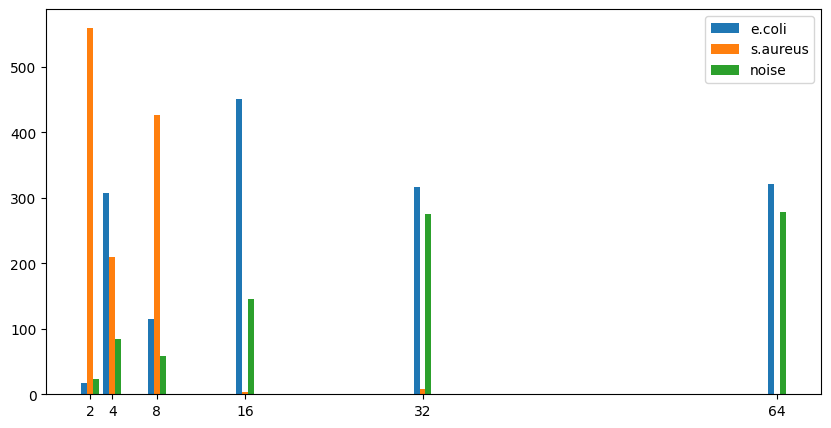

In [236]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [10, 5]
import re

pattern = re.compile("(G\d+)")

pred_ecoli_g = []
for i in range(len(pred_ecoli)):
    pred_ecoli_g.append(int(re.findall("\d+",pattern.findall(pred_ecoli[i])[0])[0]))

pred_sa_g = []
for i in range(len(pred_sa)):
    pred_sa_g.append(int(re.findall("\d+",pattern.findall(pred_sa[i])[0])[0]))

pred_noise_g = []
for i in range(len(pred_noise)):
    pred_noise_g.append(int(re.findall("\d+",pattern.findall(pred_noise[i])[0])[0]))

plt.hist((pred_ecoli_g,pred_sa_g,pred_noise_g),bins=[1,3,5,7,9,15,17,31,33,63,65],label=['e.coli','s.aureus','noise'])
plt.xticks([2,4,8,16,32,64])
plt.legend()

In [220]:
pred_noise_g

[16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 16,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 2,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32,
 32

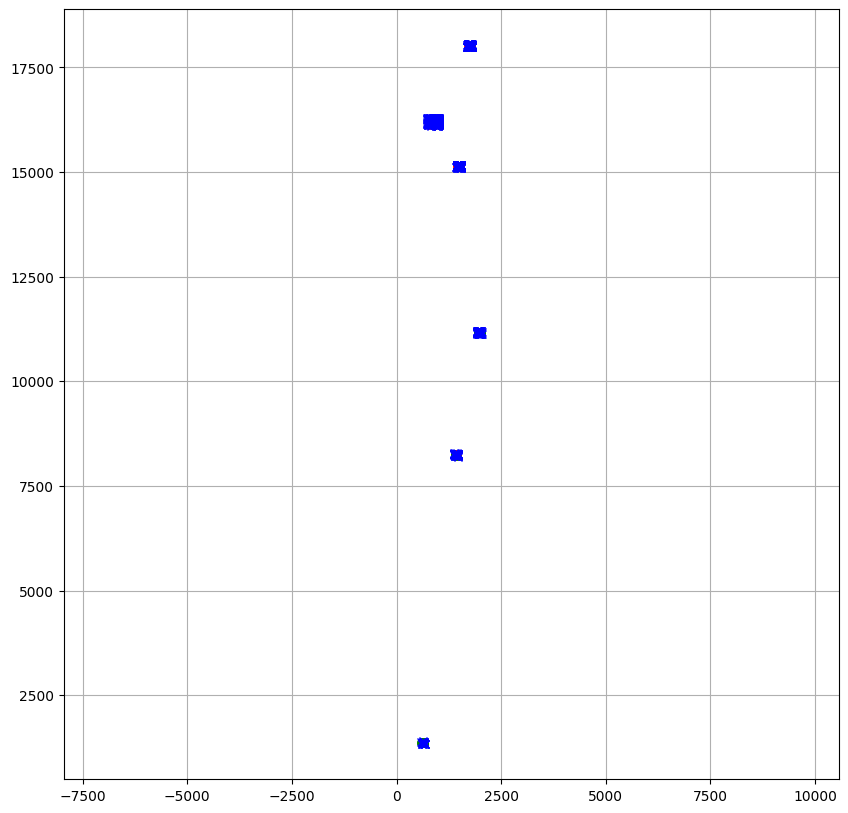

In [119]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [10, 10]
import re
pattern = re.compile("(X_\d+.\d+)")
pattern2 = re.compile("(Y_\d+.\d+)")

pred_ecoli_X = []
pred_ecoli_Y = []
for i in range(len(pred_ecoli)):
    pred_ecoli_X.append(float(re.findall("\d+.\d+",pattern.findall(pred_ecoli[i])[0])[0]))
    pred_ecoli_Y.append(float(re.findall("\d+.\d+",pattern2.findall(pred_ecoli[i])[0])[0]))

    #print(int(re.findall("\d+",pattern.findall(pred_ecoli[i])[0])[0]))
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')


pred_sa_X = []
pred_sa_Y = []
for i in range(len(pred_sa)):
    pred_sa_X.append(float(re.findall("\d+.\d+",pattern.findall(pred_sa[i])[0])[0]))
    pred_sa_Y.append(float(re.findall("\d+.\d+",pattern2.findall(pred_sa[i])[0])[0]))

    #print(int(re.findall("\d+",pattern.findall(pred_ecoli[i])[0])[0]))
plt.plot(pred_sa_X,pred_sa_Y,'g.')

pred_noise_X = []
pred_noise_Y = []
for i in range(len(pred_noise)):
    pred_noise_X.append(float(re.findall("\d+.\d+",pattern.findall(pred_noise[i])[0])[0]))
    pred_noise_Y.append(float(re.findall("\d+.\d+",pattern2.findall(pred_noise[i])[0])[0]))

    #print(int(re.findall("\d+",pattern.findall(pred_ecoli[i])[0])[0]))
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.axis('equal')
plt.grid()
#plt.xlim(500,800)
#plt.ylim(1300,1500)


In [120]:
print(pred_ecoli_X[0:10]) 
print(pred_ecoli_Y[0:10])
print(pred_sa_X[0:10]) 
print(pred_sa_Y[0:10])
print(pred_noise_X[0:10]) 
print(pred_noise_Y[0:10])

[1430.72, 1474.72, 1478.72, 1482.72, 1486.72, 1490.72, 1494.72, 1498.72, 1502.72, 1506.72]
[15100.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7]
[1530.72, 1490.72, 1502.72, 1502.72, 570.149, 610.149, 614.149, 618.149, 622.149, 626.149]
[15140.7, 15144.7, 15144.7, 15164.7, 1326.66, 1338.66, 1338.66, 1338.66, 1338.66, 1338.66]
[1470.72, 1518.72, 1522.72, 1530.72, 1534.72, 1538.72, 1542.72, 1434.72, 1454.72, 1458.72]
[15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15112.7, 15116.7, 15116.7, 15116.7]


(1320.0, 1410.0)

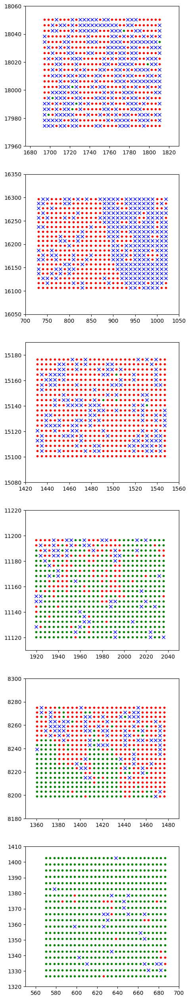

In [131]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [5,32]
plt.subplot(6,1,1)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(1675,1830)
plt.ylim(17960,18060)

plt.subplot(6,1,2)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(700,1050)
plt.ylim(16050,16350)

plt.subplot(6,1,3)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(1420,1560)
plt.ylim(15080,15190)

plt.subplot(6,1,4)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(1910,2050)
plt.ylim(11110,11220)

plt.subplot(6,1,5)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(1350,1490)
plt.ylim(8180,8300)

plt.subplot(6,1,6)               
plt.plot(pred_ecoli_X,pred_ecoli_Y,'r.')
plt.plot(pred_sa_X,pred_sa_Y,'g.')
plt.plot(pred_noise_X,pred_noise_Y,'bx')
plt.xlim(550,700)
plt.ylim(1320,1410)

In [238]:
np.array(pred_ecoli_g)*10

array([160, 160, 160, ...,  80,  80,  80])

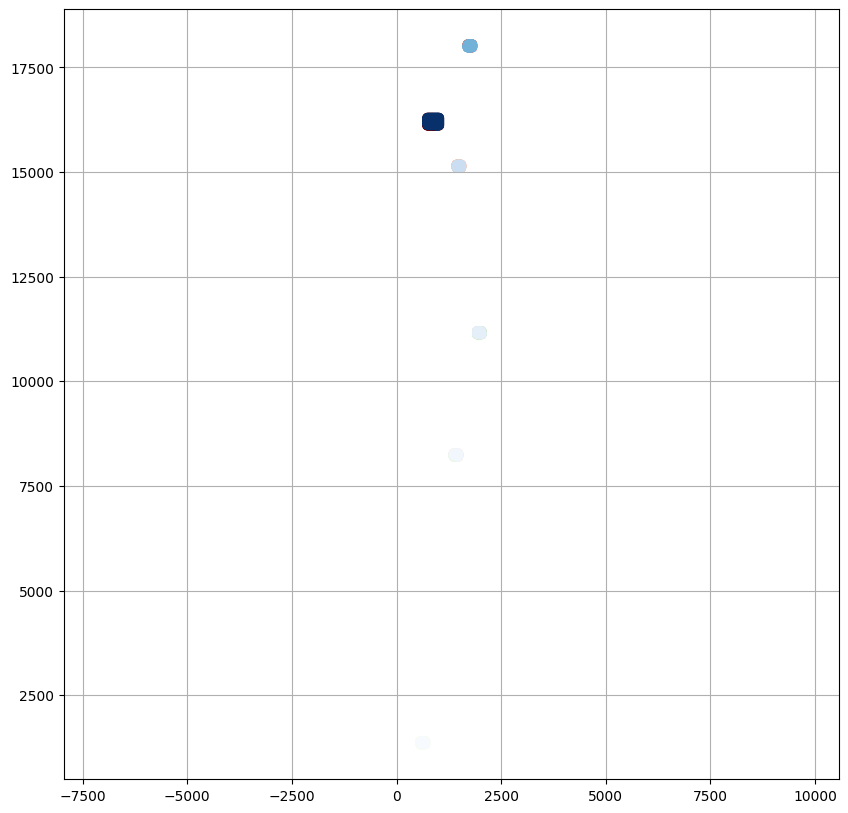

In [244]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [10, 10]

plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.axis('equal')
plt.grid()


(1320.0, 1410.0)

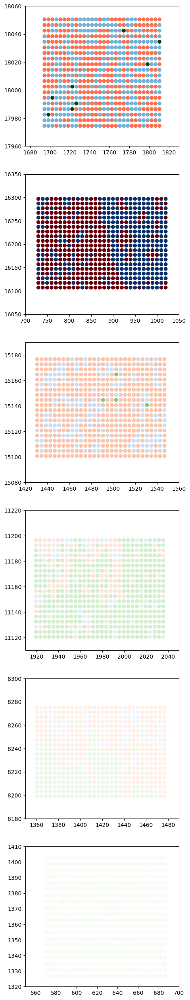

In [246]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [5,32]
plt.subplot(6,1,1)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(1675,1830)
plt.ylim(17960,18060)

plt.subplot(6,1,2)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(700,1050)
plt.ylim(16050,16350)

plt.subplot(6,1,3)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(1420,1560)
plt.ylim(15080,15190)

plt.subplot(6,1,4)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(1910,2050)
plt.ylim(11110,11220)

plt.subplot(6,1,5)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(1350,1490)
plt.ylim(8180,8300)

plt.subplot(6,1,6)               
plt.scatter(pred_ecoli_X,pred_ecoli_Y,c=pred_ecoli_g,cmap='Reds')
plt.scatter(pred_sa_X,pred_sa_Y,c=pred_sa_g,cmap='Greens')
plt.scatter(pred_noise_X,pred_noise_Y,c=pred_noise_g,cmap='Blues')
plt.xlim(550,700)
plt.ylim(1320,1410)

# Raman shift calibration

In [71]:
import requests
import json
import numpy as np
import pandas as pd
import boto3

MINSHIFT = 549.337891
MAXSHIFT = 1669.533203
INPUTDIM = 1015

def raman_shift_matching(spectrum_data,raman_shift_arr,interp_shift):

    minshift = MINSHIFT
    maxshift = MAXSHIFT
    input_dim = INPUTDIM

    if raman_shift_arr[0] > raman_shift_arr[-1]:
        print('input Flip!')
        spectrum_data = np.flip(spectrum_data)
        raman_shift_arr = np.flip(raman_shift_arr)
    if interp_shift[0] > interp_shift[-1]:
        print('interp_shift Flip!')
        interp_shift = np.flip(interp_shift)
    print(spectrum_data,raman_shift_arr)
    unit_shift = (maxshift - minshift)/input_dim
    print("unit_shift = ",unit_shift)
    unit_shift_arr = np.diff(interp_shift)
    unit_shift_arr=np.append(unit_shift_arr,unit_shift_arr[-1])
    print("unit_shift_arr.shape = ",unit_shift_arr.shape)

    #raman_shift_arr = np.array(spectrum_data['raman_shift'])
    #intensity_arr = np.array(spectrum_data['intensity'])
    intensity_arr=spectrum_data
    
    # given spectrum data interpolation for NN input format
    if minshift <= raman_shift_arr[0]:
        left_pad_flag=1
    else:
        left_pad_flag=0
    if raman_shift_arr[-1] <= maxshift:
        right_pad_flag=1
    else:
        right_pad_flag=0

    #interp_shift = np.arange(minshift,maxshift+0.0000001,unit_shift)

    print(interp_shift.shape,interp_shift[0],interp_shift[-1])

    if left_pad_flag :
        #interp_min_ind = np.where((interp_shift>(raman_shift_arr[0]-unit_shift/2)) &
        #        (interp_shift<(raman_shift_arr[0] +unit_shift/2)))[0][0]
        target_ind = np.where((interp_shift>(raman_shift_arr[0]-unit_shift/2)) &
                (interp_shift<(raman_shift_arr[0] +unit_shift/2)))[0][0]
        interp_min_ind = np.where((interp_shift>(raman_shift_arr[0]-unit_shift_arr[target_ind]/2)) &
                (interp_shift<(raman_shift_arr[0] +unit_shift_arr[target_ind]/2)))[0][0]
    else :
        #interp_min_ind = np.where((interp_shift>(minshift -unit_shift/2)) &
        #        (interp_shift<(minshift +unit_shift/2)))[0][0]
        target_ind = np.where((interp_shift>(minshift -unit_shift/2)) &
                (interp_shift<(minshift +unit_shift/2)))[0][0]
        print(target_ind)
        interp_min_ind = np.where((interp_shift>(minshift-unit_shift_arr[target_ind]/2)) &
                (interp_shift<(minshift +unit_shift_arr[target_ind]/2)))[0][0]
    if right_pad_flag:
        #interp_max_ind = np.where((interp_shift>(raman_shift_arr[-1] -unit_shift/2)) &
        #        (interp_shift<(raman_shift_arr[-1] +unit_shift/2)))[0][0]
        target_ind = np.where((interp_shift>(raman_shift_arr[-1]-unit_shift/2)) &
                (interp_shift<(raman_shift_arr[-1] +unit_shift/2)))[0][0]
        interp_max_ind = np.where((interp_shift>(raman_shift_arr[-1]-unit_shift_arr[target_ind]/2)) &
                (interp_shift<(raman_shift_arr[-1] +unit_shift_arr[target_ind]/2)))[0][0]
    else :
        #interp_max_ind = np.where((interp_shift>(maxshift -unit_shift/2)) &
        #        (interp_shift<(maxshift +unit_shift/2)))[0][0]
        target_ind = np.where((interp_shift>(maxshift-unit_shift/2)) &
                (interp_shift<(maxshift +unit_shift/2)))[0][0]
        print(target_ind)
        interp_max_ind = np.where((interp_shift>(maxshift -unit_shift_arr[target_ind]/2)) &
                (interp_shift<(maxshift +unit_shift_arr[target_ind]/2)))[0][0]
    print('interp shift - left : [{}]={}, interp shift - right : [{}]={}'
            .format(interp_min_ind,interp_shift[interp_min_ind],interp_max_ind,interp_shift[interp_max_ind]))

    interp_data = np.interp(interp_shift[interp_min_ind:interp_max_ind],
            raman_shift_arr,
            intensity_arr)

    print('the number of cropped data = {}'.format(interp_data.shape))

    # padding size check, padarray gen., concat
    merged_array = interp_data
    if left_pad_flag == 1:
        left_pad_size = interp_min_ind+1
        print('left_pad_size : ',left_pad_size)
        left_array = np.zeros(left_pad_size)
        merged_array = np.concatenate((left_array,merged_array))
    if right_pad_flag== 1:
        right_pad_size = int((maxshift- raman_shift_arr[-1])/unit_shift)
        print('right_pad_size : ',right_pad_size)
        right_array = np.zeros(right_pad_size)
        merged_array = np.concatenate((merged_array,right_array))

    print('after padding : {}'.format(merged_array.shape))

    merged_data_list = merged_array.tolist()

    return np.flip(merged_data_list)


In [72]:
for i in range(ramcell_ecoli_dataset.shape[0]):
    ramcell_ecoli_dataset[i] =  raman_shift_matching(ramcell_ecoli_dataset[i],ramcell_ecoli_wavenum,ramcell_SA_wavenum)

input Flip!
interp_shift Flip!
[-3.066056 14.967684 -8.086708 ... -0.794527 19.114393 -5.111168] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-12.117567   8.210484 -41.918701 ...  -3.204222 -35.136486 -15.909549] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ 142.486237   72.933975 -111.930862 ...  -31.82711   -29.993345
  -15.455794] [ 

interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[  -1.061866  -45.000828   37.42812  ...   58.339542 -120.289223
  -97.626945] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[  9.704287 -21.829657 -31.957085 ... -20.779703 -11.549747  -2.695102] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number 

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-84.029655 -33.275349  72.954269 ...  74.625839  20.111794 -91.611519] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ -4.595087 -40.049782 -38.827499 ...  27.049957 -31.224648 -41.377121] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-10.845611 -55.976921 -11.416485 ... -38.487064 -23.740498 -65.885323] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ 64.070007 -18.097235 -48.54792  ... -48.003525 -14.955805  23.785078] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ 127.000275 -141.186478  -60.123764 ...  297.623352  129.59407
 -133.199173] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-17.381395 -29.707031   8.812156 ...  18.975203 -44.728188 -40.287128] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the num

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[  1.03116  -23.086258  -8.033462 ... -45.968582 -39.518612  -3.855987] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ -9.245653 -19.328741  11.693171 ...   5.108167  18.063734 -10.648668] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[ 72.586533  52.69503    3.140996 ... -28.291151 -77.888779  27.330261] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-59.911766 -58.402172 -18.674171 ...  -8.430056   4.051959 -22.940176] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of

1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-22.809385   0.528506  -9.445439 ...  -2.626356 -19.547171 -29.420444] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)
input Flip!
interp_shift Flip!
[-36.38237   -7.759738 -14.37101  ... -47.56366    7.261683  -4.436256] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of

In [62]:
np.diff(ramcell_SA_wavenum)

array([-0.9873047 , -0.98828125, -0.98828125, ..., -1.2392578 ,
       -1.2392578 , -1.2402344 ], dtype=float32)

In [66]:
shifted =  raman_shift_matching(ramcell_ecoli_dataset[5],ramcell_ecoli_wavenum,ramcell_SA_wavenum)

input Flip!
interp_shift Flip!
[ -33.160404  -45.951679  -26.609598 ...   -4.841473   25.439655
 -119.548317] [ 605.130859  606.358398  607.584961 ... 1712.688477 1713.666992
 1714.646484]
unit_shift =  1.1036407014778324
unit_shift_arr.shape =  (1015,)
(1015,) 549.3379 1669.5332
1014
interp shift - left : [45]=604.8193359375, interp shift - right : [1014]=1669.533203125
the number of cropped data = (969,)
left_pad_size :  46
after padding : (1015,)


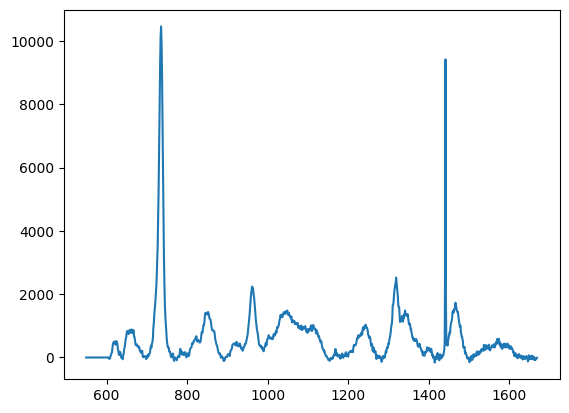

In [67]:
plt.plot(ramcell_SA_wavenum,shifted)

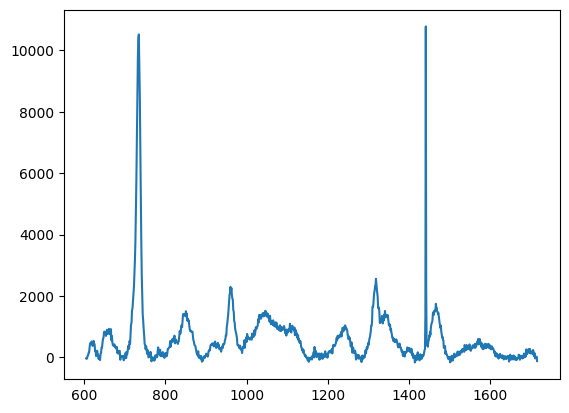

In [68]:
plt.plot(ramcell_ecoli_wavenum,ramcell_ecoli_dataset[5])

## Ramcell Train dataset E-coli + SA

In [49]:
if np.average(ramcell_ecoli_wavenum - ramcell_SA_wavenum) > 0.001:
    print("WARNING!! check ramcell wavenum!!")
racmell_wavenum = ramcell_ecoli_wavenum


ramcell_train_dataset = np.concatenate((ramcell_ecoli_dataset,ramcell_SA_dataset),axis=0)
ramcell_train_labelset = np.concatenate((np.zeros((ramcell_ecoli_dataset.shape[0])), np.ones((ramcell_SA_dataset.shape[0]))),axis=0)

data_list.append(ramcell_train_dataset)
label_list.append(ramcell_train_labelset)

x_list.append(ramcell_train_dataset)


## Ramcell Train dataset E-coli or SA

In [73]:
racmell_wavenum = ramcell_ecoli_wavenum
#racmell_wavenum = ramcell_SA_wavenum

target_bacteria_dataset = ramcell_ecoli_dataset
#target_bacteria_dataset = ramcell_SA_dataset

ramcell_train_dataset = target_bacteria_dataset
ramcell_train_labelset = np.zeros((target_bacteria_dataset.shape[0]))

data_list.append(ramcell_train_dataset)
label_list.append(ramcell_train_labelset)

x_list.append(ramcell_train_dataset)


# Ramcell data load (mix)

In [19]:
ramcell_mix6_wavenum = []
ramcell_mix6_dataset=[]
loaded_mix6_files =[]

#mix6_path = ramcell_path+"/mix_1019/"
mix6_path = ramcell_path+"/mix/6_mix/"
for file_name in os.listdir(mix6_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_mix6_files.append(file_name)
        reader = WDFReader(mix6_path+file_name)
        if len(ramcell_mix6_wavenum)==0:
            ramcell_mix6_wavenum = np.array(reader.xdata)
        ramcell_mix6_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_mix6_files.append(file_name)
        data = pd.read_csv(mix6_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_mix6_wavenum)==0:
            ramcell_mix6_wavenum = data.iloc[0:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_mix6_dataset.append(data)
        
ramcell_mix6_dataset = np.array(ramcell_mix6_dataset)
print(ramcell_mix6_dataset.shape)


(636, 1015)


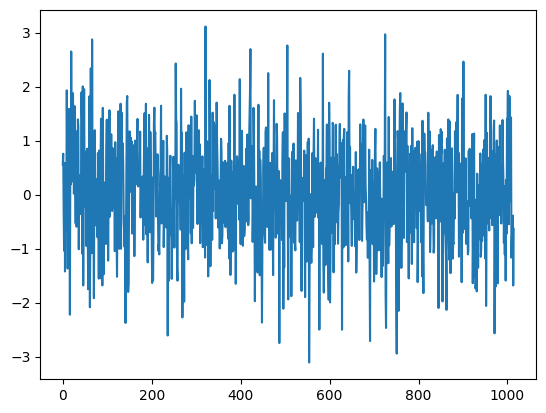

In [22]:
s = np.random.normal(0,1,1015)
plt.plot(s)

In [18]:
##############################################################################################
## FOR TEST!!!!!!!!!!!!!!!!!!!!!! noise(blank) 넣기 위해 10_6 변수에 잠시 사용
ramcell_mix6_wavenum = []
ramcell_mix6_dataset=[]
loaded_mix6_files =[]

for i in range(500):
    data = np.random.normal(0,1,1015)
    ramcell_mix6_dataset.append(data)
        
ramcell_mix6_dataset = np.array(ramcell_mix6_dataset)
print(ramcell_mix6_dataset.shape)

##############################################################################################

(500, 1015)


In [20]:
ramcell_mix8_wavenum = []
ramcell_mix8_dataset=[]
loaded_mix8_files =[]

#mix8_path = ramcell_path+"/mix_1020/10_8/"
mix8_path = ramcell_path+"/mix/8_mix/"

for file_name in os.listdir(mix8_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_mix8_files.append(file_name)
        reader = WDFReader(mix8_path+file_name)
        if len(ramcell_mix8_wavenum)==0:
            ramcell_mix8_wavenum = np.array(reader.xdata)
        ramcell_mix8_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_mix8_files.append(file_name)
        data = pd.read_csv(mix8_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_mix8_wavenum)==0:
            ramcell_mix8_wavenum = data.iloc[0:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_mix8_dataset.append(data)
        
ramcell_mix8_dataset = np.array(ramcell_mix8_dataset)
print(ramcell_mix8_dataset.shape)


(549, 1015)


In [ ]:
##############################################################################################
## FOR TEST!!!!!!!!!!!!!!!!!!!!!! 10_6 두개 넣기 위해 10_8 변수에 잠시 사용
ramcell_mix8_wavenum = []
ramcell_mix8_dataset=[]
loaded_mix8_files =[]

#mix8_path = ramcell_path+"/mix_1019/"
mix8_path = ramcell_path+"/mix/6_mix/"

for file_name in os.listdir(mix8_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_mix8_files.append(file_name)
        reader = WDFReader(mix8_path+file_name)
        if len(ramcell_mix8_wavenum)==0:
            ramcell_mix8_wavenum = np.array(reader.xdata)
        ramcell_mix8_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_mix8_files.append(file_name)
        data = pd.read_csv(mix8_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_mix8_wavenum)==0:
            ramcell_mix8_wavenum = data.iloc[0:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_mix8_dataset.append(data)
        
ramcell_mix8_dataset = np.array(ramcell_mix8_dataset)
print(ramcell_mix8_dataset.shape)

##############################################################################################

## Ramcell Train dataset add mix6+mix8

In [21]:
#if np.average(ramcell_ecoli_wavenum - ramcell_SA_wavenum) > 0.001:
#    print("WARNING!! check ramcell wavenum!!")
#racmell_wavenum = ramcell_ecoli_wavenum
#if np.average(ramcell_mix6_wavenum - ramcell_mix8_wavenum) > 0.001:
#    print("WARNING!! check ramcell wavenum!!")
racmell_wavenum = ramcell_mix8_wavenum

try:
    ramcell_train_dataset
except NameError:
    print("ramcell_train_dataset was not defiend")
    ramcell_train_dataset = np.concatenate((ramcell_mix6_dataset,ramcell_mix8_dataset),axis=0)
    ramcell_train_labelset = np.concatenate((np.zeros((ramcell_mix6_dataset.shape[0])), np.ones((ramcell_mix8_dataset.shape[0]))),axis=0)
else :
    ramcell_train_dataset = np.concatenate((ramcell_train_dataset,np.concatenate((ramcell_mix6_dataset,ramcell_mix8_dataset),axis=0)),axis=0)
    ramcell_train_labelset = np.concatenate((ramcell_train_labelset, np.concatenate((np.zeros((ramcell_mix6_dataset.shape[0]))+2, np.ones((ramcell_mix8_dataset.shape[0]))+2),axis=0)),axis=0)

data_list.append(ramcell_train_dataset)
label_list.append(ramcell_train_labelset)

x_list.append(ramcell_train_dataset)


## Ramcell Train dataset add mix8

In [278]:
#if np.average(ramcell_ecoli_wavenum - ramcell_SA_wavenum) > 0.001:
#    print("WARNING!! check ramcell wavenum!!")
#racmell_wavenum = ramcell_ecoli_wavenum
#if np.average(ramcell_mix6_wavenum - ramcell_mix8_wavenum) > 0.001:
#    print("WARNING!! check ramcell wavenum!!")
racmell_wavenum = ramcell_mix8_wavenum

try:
    ramcell_train_dataset
except NameError:
    print("ramcell_train_dataset was not defiend")
    ramcell_train_dataset = ramcell_mix8_dataset
    ramcell_train_labelset = np.zeros((ramcell_mix8_dataset.shape[0]))
else :
    ramcell_train_dataset = np.concatenate((ramcell_train_dataset,ramcell_mix8_dataset),axis=0)
    ramcell_train_labelset = np.concatenate((ramcell_train_labelset, np.zeros((ramcell_mix8_dataset.shape[0]))+2),axis=0)

data_list.append(ramcell_train_dataset)
label_list.append(ramcell_train_labelset)

x_list.append(ramcell_train_dataset)


## Ramcell covid dataset

In [50]:
ramcell_path = "/home/jeonggyu/workspace/data/CoV"
wavenum_size = 1015

In [51]:
ramcell_covid_pos_wavenum = []
ramcell_covid_pos_dataset=[]
loaded_covid_pos_files =[]

covid_pos_path = ramcell_path+"/COV/"
#covid_pos_path = ramcell_path+"/COV/CoV_Based/"

for file_name in os.listdir(covid_pos_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_covid_pos_files.append(file_name)
        reader = WDFReader(covid_pos_path+file_name)
        if len(ramcell_covid_pos_wavenum)==0:
            ramcell_covid_pos_wavenum = np.array(reader.xdata)
        ramcell_covid_pos_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_covid_pos_files.append(file_name)
        data = pd.read_csv(covid_pos_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_covid_pos_wavenum)==0:
            ramcell_covid_pos_wavenum = data.iloc[:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_covid_pos_dataset.append(data)
        
ramcell_covid_pos_dataset = np.array(ramcell_covid_pos_dataset)
print(ramcell_covid_pos_dataset.shape)


(672, 1015)


In [52]:
ramcell_covid_neg_wavenum = []
ramcell_covid_neg_dataset=[]
loaded_covid_neg_files =[]

covid_neg_path = ramcell_path+"/Neg/"
#covid_neg_path = ramcell_path+"/Neg/Neg_based/"

for file_name in os.listdir(covid_neg_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_covid_neg_files.append(file_name)
        reader = WDFReader(covid_neg_path+file_name)
        if len(ramcell_covid_neg_wavenum)==0:
            ramcell_covid_neg_wavenum = np.array(reader.xdata)
        ramcell_covid_neg_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_covid_neg_files.append(file_name)
        data = pd.read_csv(covid_neg_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_covid_neg_wavenum)==0:
            ramcell_covid_neg_wavenum = data.iloc[:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_covid_neg_dataset.append(data)
        
ramcell_covid_neg_dataset = np.array(ramcell_covid_neg_dataset)
print(ramcell_covid_neg_dataset.shape)


(748, 1015)


In [53]:
ramcell_covid_blnk_wavenum = []
ramcell_covid_blnk_dataset=[]
loaded_covid_blnk_files =[]

covid_blnk_path = ramcell_path+"/Blank/"
#covid_blnk_path = ramcell_path+"/Blank/Blank_Based/"

for file_name in os.listdir(covid_blnk_path):
    if fnmatch.fnmatch(file_name,"*.wdf"):
        loaded_covid_blnk_files.append(file_name)
        reader = WDFReader(covid_blnk_path+file_name)
        if len(ramcell_covid_blnk_wavenum)==0:
            ramcell_covid_blnk_wavenum = np.array(reader.xdata)
        ramcell_covid_blnk_dataset.append(np.array(reader.spectra))

    elif fnmatch.fnmatch(file_name,"*.txt"):
        loaded_covid_blnk_files.append(file_name)
        data = pd.read_csv(covid_blnk_path+file_name,sep="\t",engine='python',header=None) 
        if len(ramcell_covid_blnk_wavenum)==0:
            ramcell_covid_blnk_wavenum = data.iloc[:,0:1].to_numpy().astype(np.float64).reshape(wavenum_size)
        data = data.iloc[:,1:].to_numpy().astype(np.float64).reshape(wavenum_size)
        ramcell_covid_blnk_dataset.append(data)
        
ramcell_covid_blnk_dataset = np.array(ramcell_covid_blnk_dataset)
print(ramcell_covid_blnk_dataset.shape)


(810, 1015)


In [54]:
if np.average(ramcell_covid_pos_wavenum - ramcell_covid_neg_wavenum) > 0.001:
    print("WARNING!! check ramcell wavenum!!")
racmell_covid_wavenum = ramcell_covid_pos_wavenum


ramcell_covid_train_dataset = np.concatenate((ramcell_covid_pos_dataset,ramcell_covid_neg_dataset,ramcell_covid_blnk_dataset),axis=0)
ramcell_covid_train_labelset = np.concatenate((np.zeros((ramcell_covid_pos_dataset.shape[0])), 
                                               np.ones((ramcell_covid_neg_dataset.shape[0])), 
                                               np.ones((ramcell_covid_blnk_dataset.shape[0]))+1),axis=0)

data_list.append(ramcell_covid_train_dataset)
label_list.append(ramcell_covid_train_labelset)

x_list.append(ramcell_covid_train_dataset)


# loaded data shape

In [74]:
for x_ in x_list:
    print(x_.shape)
print("\n")
print(wavenum.shape)
print(wavenum_skku.shape)
print("\n")
print(ramcell_covid_train_dataset.shape)
print(ramcell_covid_train_labelset.shape)
print("\n")

#print(ramcell_ecoli_wavenum.shape)
#print(ramcell_SA_wavenum.shape)
#print(ramcell_ecoli_dataset.shape)
print(ramcell_SA_dataset.shape)
print(ramcell_train_dataset.shape)
print(ramcell_train_labelset.shape)
print(ramcell_train_labelset)

(60000, 1000)
(300000, 1000)
(300000, 1000)
(100, 1024)
(567, 1024)
(3600, 1015)


(1000,)
(1024,)




NameError: name 'ramcell_covid_train_dataset' is not defined

# SKKU Baseline remove & plot

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]

PLOT = 1

dir_path = '/home/jeonggyu/workspace/data/skku/skku/processed/'
file_list = os.listdir(dir_path)
for file in file_list:
    name,ext = os.path.splitext(file)
    if ext == '.npy':
        file_path = os.path.join(dir_path, file)
        os.remove(file_path)
ramcell_train_preprocessed =[]

for i in range(ramcell_train_dataset.shape[0]):
    #ind = random.randrange(0,100)
    ind = i
    if PLOT == 1 :
        plt.subplot(6,1,1)
        plt.plot(racmell_wavenum,x_list[4][ind],label='x_'+str(ind))

        plt.subplot(6,1,2)
        tmp = spikes_removal(x_list[4][ind],6,3)
        plt.plot(racmell_wavenum,tmp,label='x_spikes_removal_'+str(ind))

        plt.subplot(6,1,3)
        tmp = boxcar(tmp, kernel_size = 5)
        plt.plot(racmell_wavenum,tmp,label='x_boxcar_'+str(ind))
        
        plt.subplot(6,1,4)  
        #print(ind)
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        #plt.plot(racmell_wavenum,baseline,label='baseline_'+str(ind)) 

        tmp = tmp - baseline
        plt.plot(racmell_wavenum,tmp,label='x_br_'+str(ind))

        plt.subplot(6,1,5)  
        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        plt.plot(racmell_wavenum,tmp,label='x_trapz_'+str(ind))

        plt.subplot(6,1,6) 
        tmp = min_max_normalize(tmp)
        plt.plot(racmell_wavenum,tmp,label='x_minmax_'+str(ind)) 
    else:
        tmp = spikes_removal(x_list[4][ind],6,3)
        
        tmp = boxcar(tmp, kernel_size = 5)
        
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        tmp = tmp - baseline
        

        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        
        tmp = min_max_normalize(tmp)
        
    ramcell_train_preprocessed.append(tmp)
    np.save(dir_path+'spot'+str(i+1)+'.npy',tmp)

#plt.legend()
np.save(dir_path+'wavenum.npy',racmell_wavenum)
np.save(dir_path+'label.npy',ramcell_train_labelset)



In [21]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]

skku_train_preprocessed =[]

for i in range(skku_train_dataset.shape[0]):
    #ind = random.randrange(0,100)
    ind = i
    plt.subplot(4,1,1)
    #baseline, _ = pybaselines.whittaker.airpls(x_list[4][ind]) 
    baseline, _ = pybaselines.whittaker.psalsa(x_list[4][ind])
    plt.plot(wavenum_skku,x_list[4][ind],label='x_'+str(ind))
    plt.plot(wavenum_skku,baseline,label='baseline_'+str(ind))
    plt.subplot(4,1,2)
    tmp = x_list[4][ind]-baseline     
    plt.plot(wavenum_skku,tmp,label='x_'+str(ind))
    plt.subplot(4,1,3) 
    #tmp_ = min_max_normalize(tmp)
    integ = np.trapz(tmp)
    if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
    tmp_ = tmp/integ
    plt.ylim(-0.02,0.05)
    plt.plot(wavenum_skku,tmp_,label='x_'+str(ind)) 

    '''
    plt.subplot(4,1,4)
    tmp_ = {'intensity':tmp_,'raman_shift':wavenum_skku}
    tmp_ = np.array(raman_shift_matching(tmp_)) 
    plt.plot(wavenum,tmp_,label='x_'+str(ind))
    '''
    skku_train_preprocessed.append(tmp_)
    np.save('/home/jeonggyu/workspace/data/skku/skku/processed/spot'+str(i+1)+'.npy',tmp_)

#plt.legend()
np.save('/home/jeonggyu/workspace/data/skku/skku/processed/wavenum.npy',wavenum_skku)
np.save('/home/jeonggyu/workspace/data/skku/skku/processed/label.npy',skku_train_labelset)



Error in callback <function flush_figures at 0x7f206611f200> (for post_execute):


KeyboardInterrupt: 

In [ ]:
skku_preprocessed =[]
for i in range(100):
    #ind = random.randrange(0,100)
    ind = i
    plt.subplot(4,1,1)
    #baseline, _ = pybaselines.whittaker.airpls(x_list[3][ind])
    baseline, _ = pybaselines.whittaker.psalsa(x_list[3][ind])
    plt.plot(wavenum_skku,x_list[3][ind],label='x_'+str(ind))
    plt.plot(wavenum_skku,baseline,label='baseline_'+str(ind))
    plt.subplot(4,1,2)
    tmp = x_list[3][ind]-baseline     
    plt.plot(wavenum_skku,tmp,label='x_'+str(ind))
    plt.subplot(4,1,3) 
    #tmp_ = min_max_normalize(tmp)
    integ = np.trapz(tmp)
    if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
    tmp_ = tmp/integ    
    plt.plot(wavenum_skku,tmp_,label='x_'+str(ind))
    '''
    plt.subplot(4,1,4)
    tmp_ = {'intensity':tmp_,'raman_shift':wavenum_skku}
    tmp_ = np.array(raman_shift_matching(tmp_))
    plt.plot(wavenum,tmp_,label='x_'+str(ind))
    '''
    skku_preprocessed.append(tmp_)
    np.save('/home/jeonggyu/workspace/data/skku/processed/spot'+str(i+1)+'.npy',tmp_)
#plt.legend()
np.save('/home/jeonggyu/workspace/data/skku/processed/wavenum.npy',wavenum_skku)
np.save('/home/jeonggyu/workspace/data/skku/processed/label.npy',np.ones(100))


# Ramcell Spikes Removal, Baseline removal, Boxcar, Trapz, Min-max, plot

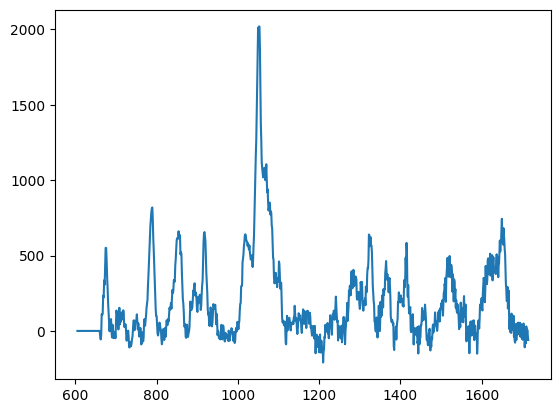

In [75]:
plt.plot(racmell_wavenum,x_list[5][1000])

### only pure or only mixture

/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/pybaselines/whittaker.py:312: ParameterWarning: almost all baseline points are below the data, indicating that "tol" is too low and/or "max_iter" is too high
  ' is too low and/or "max_iter" is too high'), ParameterWarning


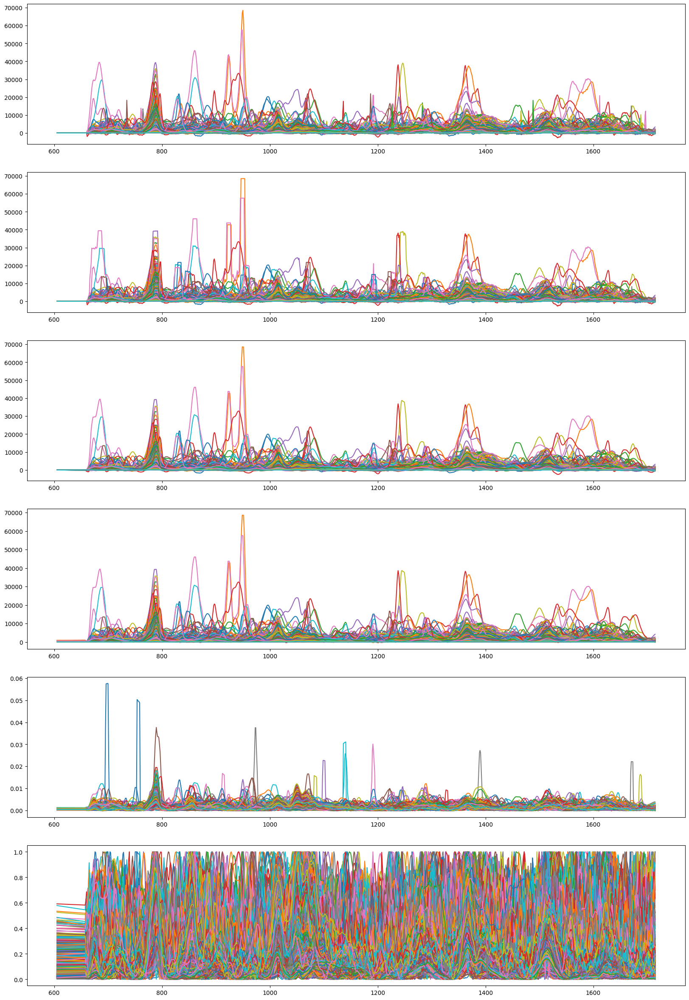

In [76]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]

PLOT = 1

dir_path = '/home/jeonggyu/workspace/data/ramcell/processed/'
file_list = os.listdir(dir_path)
for file in file_list:
    name,ext = os.path.splitext(file)
    if ext == '.npy':
        file_path = os.path.join(dir_path, file)
        os.remove(file_path)
ramcell_train_preprocessed =[]

for i in range(ramcell_train_dataset.shape[0]):
    #ind = random.randrange(0,100)
    ind = i
    if PLOT == 1 :
        plt.subplot(6,1,1)
        plt.plot(racmell_wavenum,x_list[5][ind],label='x_'+str(ind))

        plt.subplot(6,1,2)
        tmp = spikes_removal(x_list[5][ind],6,3)
        plt.plot(racmell_wavenum,tmp,label='x_spikes_removal_'+str(ind))

        plt.subplot(6,1,3)
        tmp = boxcar(tmp, kernel_size = 5)
        plt.plot(racmell_wavenum,tmp,label='x_boxcar_'+str(ind))
        
        plt.subplot(6,1,4)  
        #print(ind)
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        #plt.plot(racmell_wavenum,baseline,label='baseline_'+str(ind)) 

        tmp = tmp - baseline
        plt.plot(racmell_wavenum,tmp,label='x_br_'+str(ind))

        plt.subplot(6,1,5)  
        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        plt.plot(racmell_wavenum,tmp,label='x_trapz_'+str(ind))

        plt.subplot(6,1,6) 
        tmp = min_max_normalize(tmp)
        plt.plot(racmell_wavenum,tmp,label='x_minmax_'+str(ind)) 
    else:
        tmp = spikes_removal(x_list[5][ind],6,3)
        
        tmp = boxcar(tmp, kernel_size = 5)
        
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        tmp = tmp - baseline
        

        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        
        tmp = min_max_normalize(tmp)
        
    ramcell_train_preprocessed.append(tmp)
    np.save(dir_path+'spot'+str(i+1)+'.npy',tmp)

#plt.legend()
np.save(dir_path+'wavenum.npy',racmell_wavenum)
np.save(dir_path+'label.npy',ramcell_train_labelset)



### pure and mixture

/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/pybaselines/whittaker.py:312: ParameterWarning: almost all baseline points are below the data, indicating that "tol" is too low and/or "max_iter" is too high
  ' is too low and/or "max_iter" is too high'), ParameterWarning
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/pybaselines/whittaker.py:297: ParameterWarning: error occurred during fitting, indicating that "tol" is too low, "max_iter" is too high, or "lam" is too high
  ParameterWarning


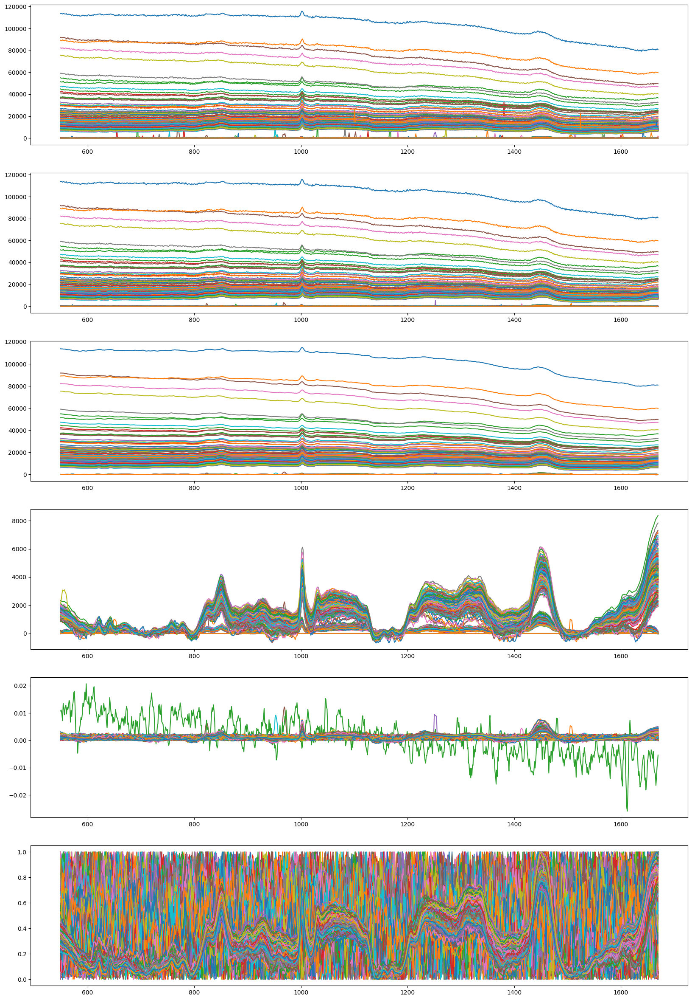

In [22]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]

PLOT = 1

dir_path = '/home/jeonggyu/workspace/data/ramcell/processed/'
file_list = os.listdir(dir_path)
for file in file_list:
    name,ext = os.path.splitext(file)
    if ext == '.npy':
        file_path = os.path.join(dir_path, file)
        os.remove(file_path)
ramcell_train_preprocessed =[]

for i in range(ramcell_train_dataset.shape[0]):
    #ind = random.randrange(0,100)
    ind = i
    if PLOT == 1 :
        plt.subplot(6,1,1)
        plt.plot(racmell_wavenum,x_list[6][ind],label='x_'+str(ind))

        plt.subplot(6,1,2)
        tmp = spikes_removal(x_list[6][ind],6,3)
        plt.plot(racmell_wavenum,tmp,label='x_spikes_removal_'+str(ind))

        plt.subplot(6,1,3)
        tmp = boxcar(tmp, kernel_size = 5)
        plt.plot(racmell_wavenum,tmp,label='x_boxcar_'+str(ind))
        
        plt.subplot(6,1,4)  
        #print(ind)
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        #plt.plot(racmell_wavenum,baseline,label='baseline_'+str(ind)) 

        tmp = tmp - baseline
        plt.plot(racmell_wavenum,tmp,label='x_br_'+str(ind))

        plt.subplot(6,1,5)  
        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        plt.plot(racmell_wavenum,tmp,label='x_trapz_'+str(ind))

        plt.subplot(6,1,6) 
        tmp = min_max_normalize(tmp)
        plt.plot(racmell_wavenum,tmp,label='x_minmax_'+str(ind)) 
    else:
        tmp = spikes_removal(x_list[6][ind],6,3)
        
        tmp = boxcar(tmp, kernel_size = 5)
        
        baseline, _ = pybaselines.whittaker.airpls(tmp) 
        #baseline, _ = pybaselines.whittaker.psalsa(tmp)
        tmp = tmp - baseline
        

        integ = np.trapz(tmp)
        if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
        tmp = tmp/integ
        
        tmp = min_max_normalize(tmp)
        
    ramcell_train_preprocessed.append(tmp)
    np.save(dir_path+'spot'+str(i+1)+'.npy',tmp)

#plt.legend()
np.save(dir_path+'wavenum.npy',racmell_wavenum)
np.save(dir_path+'label.npy',ramcell_train_labelset)



# COVID preprocessing

In [56]:
x_list[5].shape

(762, 1015)

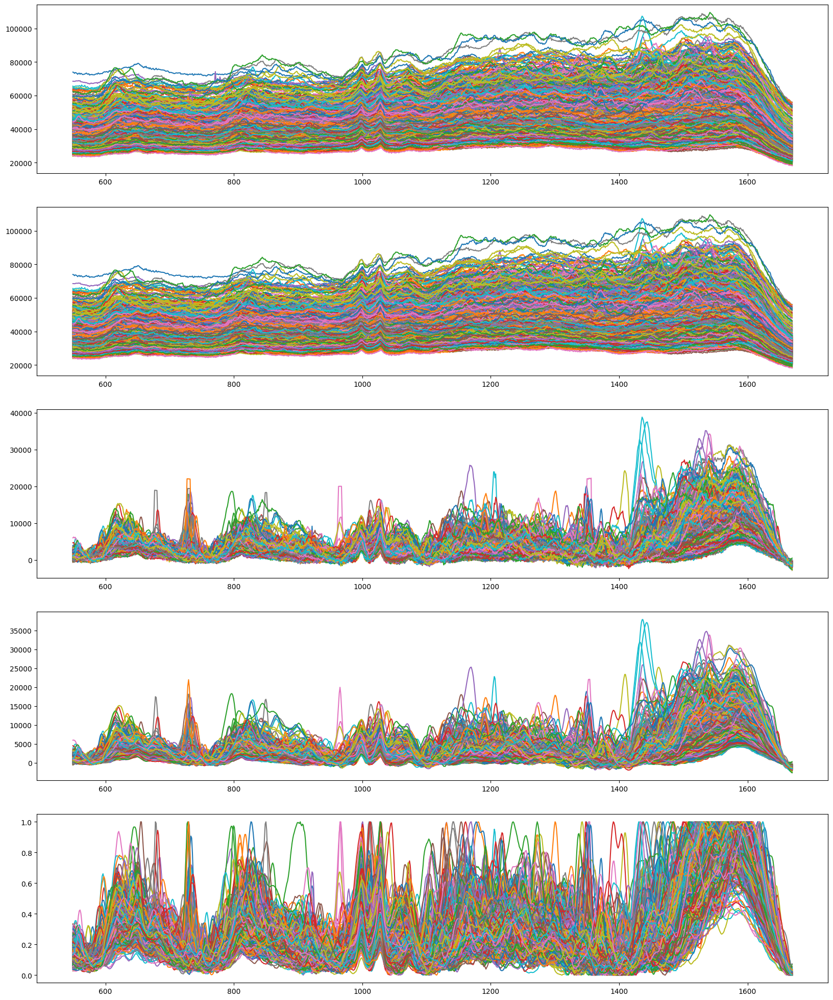

In [57]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]

def ramcell_preprocessing(x,y,wavenum,dir_path,show):
    file_list = os.listdir(dir_path)
    for file in file_list:
        name,ext = os.path.splitext(file)
        if ext == '.npy':
            file_path = os.path.join(dir_path, file)
            os.remove(file_path)
    preprocessed =[]

    for i in range(x.shape[0]):
        #ind = random.randrange(0,100)
        ind = i
        if show == 1 :
            plt.subplot(6,1,1)
            plt.plot(wavenum,x[ind],label='x_'+str(ind))

            plt.subplot(6,1,2)
            tmp = spikes_removal(x[ind],6,3)
            plt.plot(wavenum,tmp,label='x_spikes_removal_'+str(ind))

            plt.subplot(6,1,3)
            #print(ind)
            baseline, _ = pybaselines.whittaker.airpls(tmp) 
            #baseline, _ = pybaselines.whittaker.psalsa(tmp)
            #plt.plot(racmell_wavenum,baseline,label='baseline_'+str(ind)) 

            tmp = tmp - baseline
            plt.plot(wavenum,tmp,label='x_br_'+str(ind))

            plt.subplot(6,1,4)  
            tmp = boxcar(tmp, kernel_size = 5)
            plt.plot(wavenum,tmp,label='x_boxcar_'+str(ind))


            #plt.subplot(6,1,5)  
            #integ = np.trapz(tmp)
            #if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
            #tmp = tmp/integ
            #plt.plot(wavenum,tmp,label='x_trapz_'+str(ind))

            plt.subplot(6,1,5) 
            tmp = min_max_normalize(tmp)
            plt.plot(wavenum,tmp,label='x_minmax_'+str(ind)) 
        else:
            tmp = spikes_removal(x[ind],6,3)

            tmp = boxcar(tmp, kernel_size = 5)

            baseline, _ = pybaselines.whittaker.airpls(tmp) 
            #baseline, _ = pybaselines.whittaker.psalsa(tmp)
            tmp = tmp - baseline


            integ = np.trapz(tmp)
            if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
            tmp = tmp/integ

            tmp = min_max_normalize(tmp)

        preprocessed.append(tmp)
        np.save(dir_path+'spot'+str(i+1)+'.npy',tmp)

    #plt.legend()
    np.save(dir_path+'wavenum.npy',wavenum)
    np.save(dir_path+'label.npy',y)
    return preprocessed

covid_preprocessed = ramcell_preprocessing(x_list[6],ramcell_covid_train_labelset,racmell_covid_wavenum,'/home/jeonggyu/workspace/data/CoV/processed/',1)

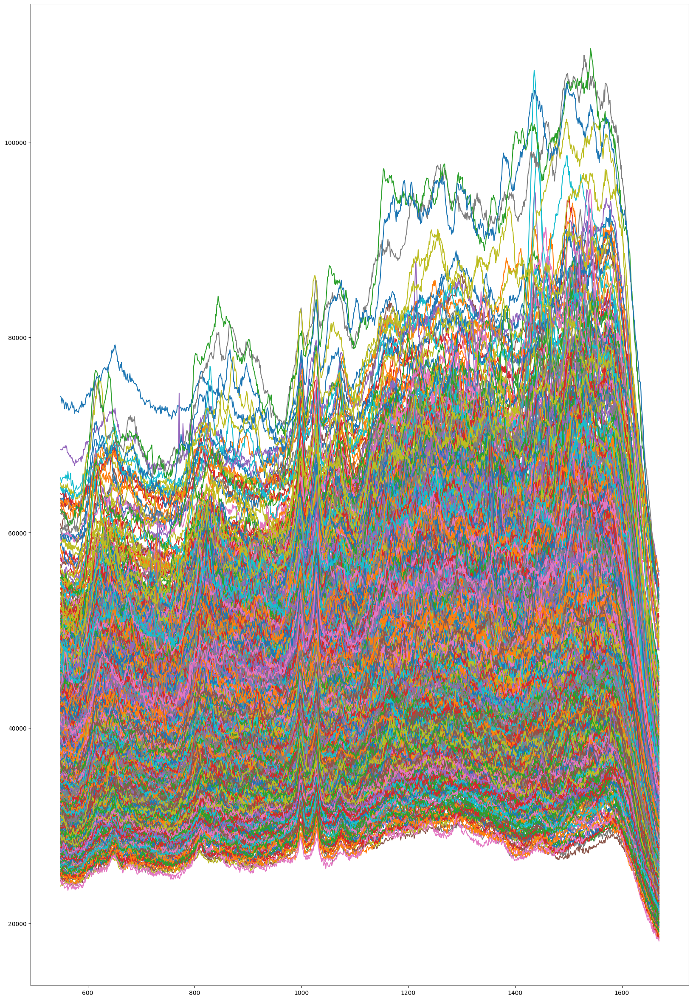

In [25]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]

def ramcell_preprocessing(x,y,wavenum,dir_path,show):
    file_list = os.listdir(dir_path)
    for file in file_list:
        name,ext = os.path.splitext(file)
        if ext == '.npy':
            file_path = os.path.join(dir_path, file)
            os.remove(file_path)
    preprocessed =[]

    for i in range(x.shape[0]):
        if show == 1 :
            plt.subplot(1,1,1)
            plt.plot(wavenum,x[i],label='x_'+str(i))
        preprocessed.append(x[i])
        np.save(dir_path+'spot'+str(i+1)+'.npy',x[i])

    #plt.legend()
    np.save(dir_path+'wavenum.npy',wavenum)
    np.save(dir_path+'label.npy',y)
    return preprocessed

covid_preprocessed = ramcell_preprocessing(x_list[5],ramcell_covid_train_labelset,racmell_covid_wavenum,'/home/jeonggyu/workspace/data/CoV/processed/',1)

In [26]:
print(ramcell_covid_train_labelset[0:672])
print(ramcell_covid_train_labelset[672:672+748])
print(ramcell_covid_train_labelset[672+748:672+748+810])
x_pos = np.array(covid_preprocessed[0:672])
x_neg = np.array(covid_preprocessed[672:672+748])
x_blnk = np.array(covid_preprocessed[672+748:672+748+810])

[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.

(672, 1015)
(748, 1015)
(810, 1015)


Text(0.5, 1.0, 'std')

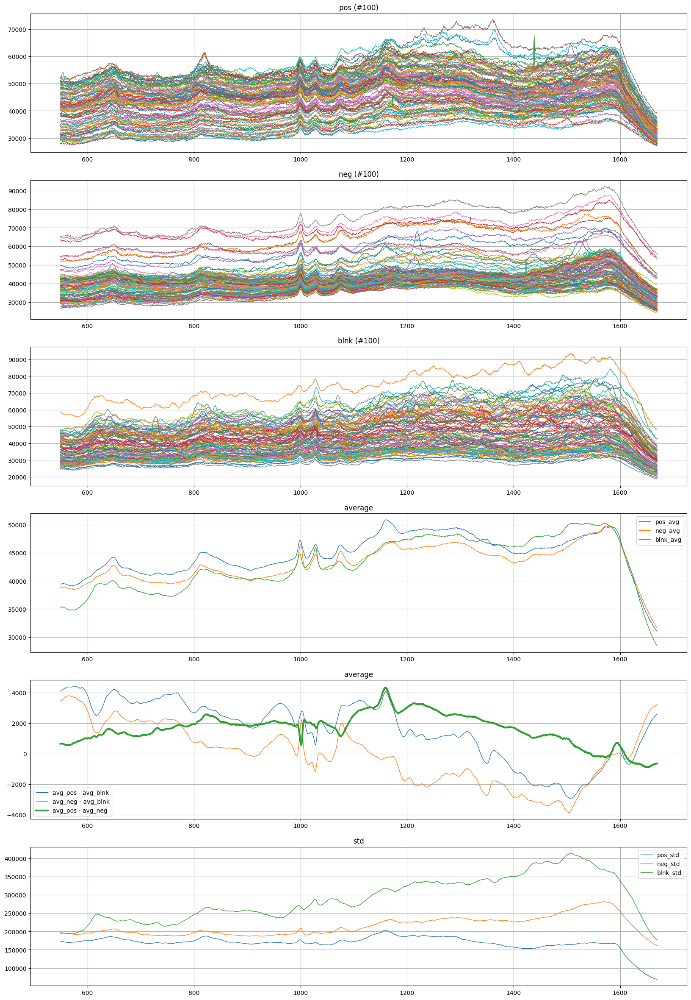

In [30]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 40]
print(x_pos.shape)
print(x_neg.shape)
print(x_blnk.shape)

plt.subplot(8,1,1)
#plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(racmell_covid_wavenum,x_pos[i],label='pos'+str(i),linewidth=1)
#plt.legend()
plt.grid()
plt.title('pos (#100)')

plt.subplot(8,1,2)
#plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(racmell_covid_wavenum,x_neg[i],label='neg'+str(i),linewidth=1)
#plt.legend()
plt.grid()
plt.title('neg (#100)')
    
plt.subplot(8,1,3)
#plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(racmell_covid_wavenum,x_blnk[i],label='blnk'+str(i),linewidth=1)
#plt.legend()
plt.grid()
plt.title('blnk (#100)')
    
    
avg_pos = avg(x_pos,0,x_pos.shape[0],1015)
avg_neg = avg(x_neg,0,x_neg.shape[0],1015)
avg_blnk = avg(x_blnk,0,x_blnk.shape[0],1015)

plt.subplot(8,1,4)
#plt.ylim(-0.005,1.1)
plt.plot(racmell_covid_wavenum,avg_pos,label='pos_avg',linewidth=1)
plt.plot(racmell_covid_wavenum,avg_neg,label='neg_avg',linewidth=1)
plt.plot(racmell_covid_wavenum,avg_blnk,label='blnk_avg',linewidth=1)
plt.legend()
plt.grid()
plt.title('average')

plt.subplot(8,1,5)
#plt.ylim(-0.5,0.5)
plt.plot(racmell_covid_wavenum,avg_pos-avg_blnk,label='avg_pos - avg_blnk',linewidth=1)
plt.plot(racmell_covid_wavenum,avg_neg-avg_blnk,label='avg_neg - avg_blnk',linewidth=1)
plt.plot(racmell_covid_wavenum,avg_pos-avg_neg,label='avg_pos - avg_neg',linewidth=3)
plt.legend()
plt.grid()
plt.title('average')

x_pos_std = std(x_pos,avg_pos,0,x_pos.shape[0],1015)
x_neg_std = std(x_neg,avg_neg,0,x_neg.shape[0],1015)
x_blnk_std = std(x_blnk,avg_blnk,0,x_blnk.shape[0],1015)

plt.subplot(8,1,6)
plt.plot(racmell_covid_wavenum,x_pos_std,label='pos_std',linewidth=1)
plt.plot(racmell_covid_wavenum,x_neg_std,label='neg_std',linewidth=1)
plt.plot(racmell_covid_wavenum,x_blnk_std,label='blnk_std',linewidth=1)
plt.legend()
plt.grid()
plt.title('std')


# smoothing test

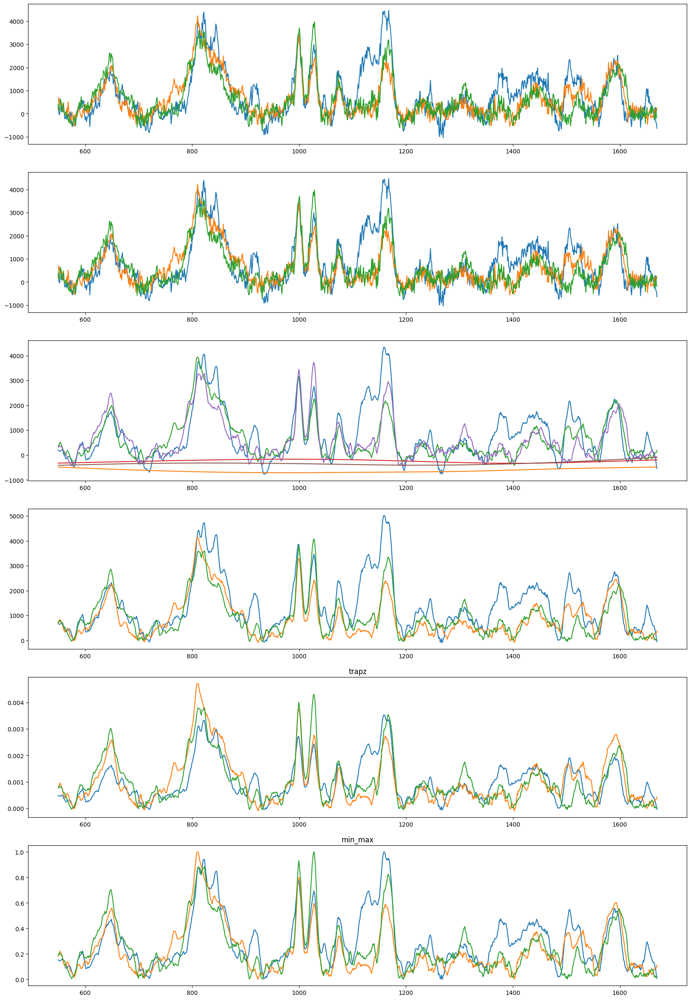

In [53]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 30]


for i in range(3):
    #ind = random.randrange(0,100)
    ind = i
    plt.subplot(6,1,1)
    plt.plot(racmell_wavenum,x_list[6][ind],label='x_'+str(ind))

    plt.subplot(6,1,2)
    tmp = spikes_removal(x_list[6][ind],6,3)
    plt.plot(racmell_wavenum,tmp,label='x_spikes_removal_'+str(ind))
    
    plt.subplot(6,1,3)  
    tmp = boxcar(tmp, kernel_size = 5)
    plt.plot(racmell_wavenum,tmp,label='x_boxcar_'+str(ind))
    
    
    plt.subplot(6,1,3)
    baseline, _ = pybaselines.whittaker.airpls(tmp) 
    #baseline, _ = pybaselines.whittaker.psalsa(tmp)
    plt.plot(racmell_wavenum,baseline,label='baseline_'+str(ind)) 

    plt.subplot(6,1,4)
    tmp = tmp - baseline
    plt.plot(racmell_wavenum,tmp,label='x_br_'+str(ind))

    plt.subplot(6,1,5)  
    integ = np.trapz(tmp)
    if integ < 0 : print("integ < 0 !! it might be error to apply trapz")
    tmp_trapz = tmp/integ
    plt.plot(racmell_wavenum,tmp_trapz,label='x_trapz_'+str(ind))
    plt.title("trapz")

    plt.subplot(6,1,6) 
    tmp_min_max = min_max_normalize(tmp)
    plt.plot(racmell_wavenum,tmp_min_max,label='x_minmax_'+str(ind)) 
    plt.title("min_max")



# Bacteria-ID augmented data separation

In [ ]:
print(auged_dataset.shape)
print(auged_dataset_neg.shape)
print(auged_labelset.shape)
print(auged_labelset_neg.shape)
auged_dataset = np.reshape(auged_dataset,(30,10000,1000))
auged_dataset_neg = np.reshape(auged_dataset_neg,(30,10000,1000))
auged_labelset = np.reshape(auged_labelset,(30,10000))
auged_labelset_neg = np.reshape(auged_labelset_neg,(30,10000))
for i in range(30):
    seed = np.random.randint(0,100000)
    tmp = np.concatenate((auged_dataset[i],auged_dataset_neg[i]),axis=0)
    tmp_label = np.concatenate((auged_labelset[i],auged_labelset_neg[i]),axis=0)
    np.random.seed(seed)
    np.random.shuffle(tmp)
    np.random.seed(seed)
    np.random.shuffle(tmp_label)
    tmp_label = np.reshape(tmp_label,(20000,1))
    print(tmp.shape,tmp_label.shape)
    print('seed = '+str(seed))
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/'+str(i)+'label',tmp_label)

In [ ]:
print(auged_dataset.shape)
print(auged_dataset_neg.shape)
print(auged_labelset.shape)
print(auged_labelset_neg.shape)
auged_dataset = np.reshape(auged_dataset,(30,10000,1000))
auged_dataset_neg = np.reshape(auged_dataset_neg,(30,10000,1000))
auged_labelset = np.reshape(auged_labelset,(30,10000))
auged_labelset_neg = np.reshape(auged_labelset_neg,(30,10000))
print(auged_dataset.shape)
print(auged_dataset_neg.shape)
print(auged_labelset.shape)
print(auged_labelset_neg.shape)
print(auged_dataset[0][0][0],auged_dataset_neg[0][0][0],end='\n\n')
print(auged_labelset[0],auged_labelset_neg[0],end='\n\n')
tmp = np.concatenate((auged_dataset[0],auged_dataset_neg[0]),axis=0)
tmp_label = np.concatenate((auged_labelset[0],auged_labelset_neg[0]),axis=0)
print(tmp.shape,tmp_label.shape)

print(tmp[0][0],tmp[10000][0],end='\n\n')
print(tmp_label[0],tmp_label[10000],end='\n\n')
seed = np.random.randint(0,100000)
np.random.seed(seed)
np.random.shuffle(tmp)
np.random.seed(seed)
np.random.shuffle(tmp_label)
print(tmp.shape,tmp_label.shape)
print(tmp[0][0],tmp[10000][0],end='\n\n')
print(tmp_label[0],tmp_label[10000],end='\n\n')

for i in range(100):
    print(tmp_label[i])

In [ ]:
tmp=[[1,2,3],[4,5,6],[7,8,9],[2,4,6]]
tmp_label=[1,2,3,4]
seed = np.random.randint(0,100000)
np.random.seed(seed)
np.random.shuffle(tmp)
np.random.seed(seed)
np.random.shuffle(tmp_label)
print(tmp,tmp_label)


# SKKU data oversampling & integration

In [ ]:
smote = SMOTE()
adasyn = ADASYN(random_state=1,n_neighbors=5)
skku_train_preprocessed=np.array(skku_train_preprocessed)
print(skku_train_preprocessed.shape)
skku_train_smote,skku_labelset_smote=smote.fit_resample(skku_train_preprocessed,skku_train_labelset)
skku_train_adasyn,skku_labelset_adasyn=adasyn.fit_resample(skku_train_preprocessed,skku_train_labelset)
print(skku_train_smote.shape)
print(skku_labelset_smote.shape)
print(skku_train_adasyn.shape)
print(skku_labelset_adasyn.shape)
print(Counter(skku_train_labelset))
print(Counter(skku_labelset_smote))
plt.plot(skku_train_smote[600],label='smote_600')
plt.plot(skku_train_smote[0],label='smote_0')
plt.plot(skku_train_adasyn[600],label='adasyn_600')
plt.legend()


In [ ]:
print(skku_train_preprocessed.shape)
print(skku_train_labelset.shape)

In [ ]:
for i in range(1):
    seed = np.random.randint(0,100000)
    tmp = skku_train_smote
    tmp_label = skku_labelset_smote
    # SMOTE, ADASYN이 이미 shuffle 해줌
    #np.random.seed(seed)
    #np.random.shuffle(tmp)
    #np.random.seed(seed)
    #np.random.shuffle(tmp_label)
    tmp_label = np.reshape(tmp_label,(tmp_label.shape[0],1))
    print(tmp.shape,tmp_label.shape)
    print('seed = '+str(seed))
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/'+str(i)+'label',tmp_label)

# Ramcell data oversampling & integration

In [27]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]
smote = SMOTE()
#adasyn = ADASYN(sampling_strategy='minority',random_state=1,n_neighbors=5)
ramcell_train_preprocessed=np.array(ramcell_train_preprocessed)
print(ramcell_train_preprocessed.shape)
ramcell_train_smote,ramcell_labelset_smote=smote.fit_resample(ramcell_train_preprocessed,ramcell_train_labelset)
#ramcell_train_adasyn,ramcell_labelset_adasyn=adasyn.fit_resample(ramcell_train_preprocessed,ramcell_train_labelset)
print(ramcell_train_smote.shape)
print(ramcell_labelset_smote.shape)
#print(ramcell_train_adasyn.shape)
#print(ramcell_labelset_adasyn.shape)
print(Counter(ramcell_train_labelset))
print(Counter(ramcell_labelset_smote))
#print(Counter(ramcell_labelset_adasyn))
plt.plot(ramcell_train_smote[0],label='smote_0')
#plt.plot(ramcell_train_adasyn[0],label='adasyn_0')
plt.legend()
#print(ramcell_labelset_adasyn)

(3600, 1015)


ValueError: The target 'y' needs to have more than 1 class. Got 1 class instead

In [26]:
print(ramcell_train_smote.shape)
print(ramcell_labelset_smote.shape)

(2196, 1015)
(2196,)


In [27]:
for i in range(1):
    seed = np.random.randint(0,100000)
    tmp = ramcell_train_smote
    tmp_label = ramcell_labelset_smote
    np.random.seed(seed)
    np.random.shuffle(tmp)
    np.random.seed(seed)
    np.random.shuffle(tmp_label)
    tmp_label = np.reshape(tmp_label,(tmp_label.shape[0],1))
    print(tmp.shape,tmp_label.shape)
    print('seed = '+str(seed))
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell/'+str(i)+'label',tmp_label)

(2196, 1015) (2196, 1)
seed = 14231


# Covid data oversampling & integration

(2230, 1015)
(2430, 1015)
(2430,)
Counter({2.0: 810, 1.0: 748, 0.0: 672})
Counter({0.0: 810, 1.0: 810, 2.0: 810})
(2430, 1015)
(2430,)


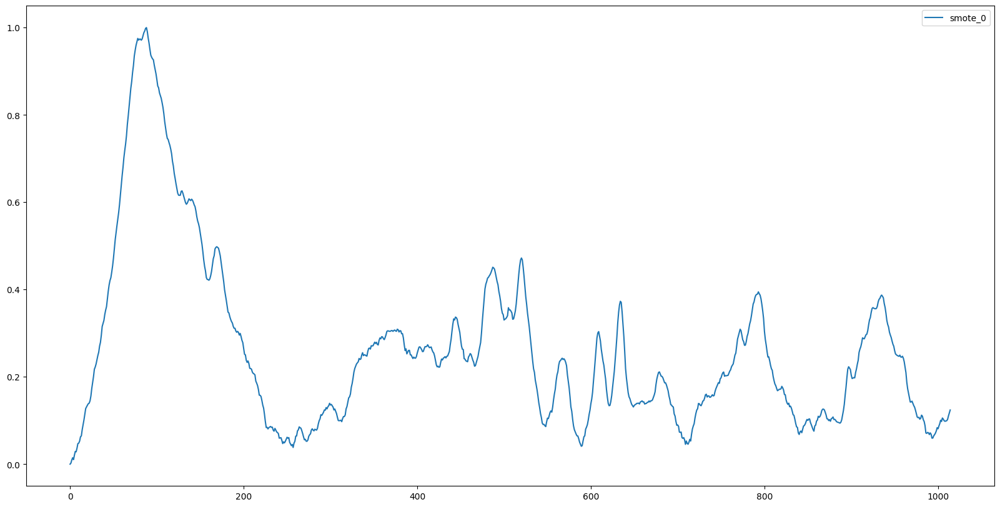

In [58]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 10]
smote = SMOTE()
#adasyn = ADASYN(sampling_strategy='minority',random_state=1,n_neighbors=5)
covid_preprocessed=np.array(covid_preprocessed)
print(covid_preprocessed.shape)
ramcell_train_smote,ramcell_labelset_smote=smote.fit_resample(covid_preprocessed,ramcell_covid_train_labelset)
#ramcell_train_adasyn,ramcell_labelset_adasyn=adasyn.fit_resample(covid_preprocessed,ramcell_covid_train_labelset)
print(ramcell_train_smote.shape)
print(ramcell_labelset_smote.shape)
#print(ramcell_train_adasyn.shape)
#print(ramcell_labelset_adasyn.shape)
print(Counter(ramcell_covid_train_labelset))
print(Counter(ramcell_labelset_smote))
#print(Counter(ramcell_labelset_adasyn))
plt.plot(ramcell_train_smote[0],label='smote_0')
#plt.plot(ramcell_train_adasyn[0],label='adasyn_0')
plt.legend()
#print(ramcell_labelset_adasyn)

print(ramcell_train_smote.shape)
print(ramcell_labelset_smote.shape)

In [59]:
for i in range(1):
    seed = np.random.randint(0,100000)
    tmp = ramcell_train_smote
    tmp_label = ramcell_labelset_smote
    np.random.seed(seed)
    np.random.shuffle(tmp)
    np.random.seed(seed)
    np.random.shuffle(tmp_label)
    tmp_label = np.reshape(tmp_label,(tmp_label.shape[0],1))
    print(tmp.shape,tmp_label.shape)
    print('seed = '+str(seed))
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/covid/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/covid/'+str(i)+'label',tmp_label)

(2430, 1015) (2430, 1)
seed = 26752


# blended dataset separation

In [ ]:
blended_dataset = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/auged_dataset.npy')
blended_labelset = np.load('/home/jeonggyu/workspace/piccolo/spectre/src/spectre/data_augmentation/auged_data/auged_labelset.npy')
blended_dataset=np.reshape(blended_dataset,(blended_dataset.shape[0]*blended_dataset.shape[1],blended_dataset.shape[2]))
blended_labelset=np.reshape(blended_labelset,(blended_labelset.shape[0]*blended_labelset.shape[1],1))

print(blended_dataset.shape)
print(blended_labelset.shape)

for i in range(1):
    seed = np.random.randint(0,100000)
    tmp = blended_dataset
    tmp_label = blended_labelset
    np.random.seed(seed)
    np.random.shuffle(tmp)
    np.random.seed(seed)
    np.random.shuffle(tmp_label)
    tmp_label = np.reshape(tmp_label,(tmp_label.shape[0],1))
    print(tmp.shape,tmp_label.shape)
    print('seed = '+str(seed))
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell_blended/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell_blended/'+str(i)+'label',tmp_label)


# E. Coli -> component.npy

In [77]:


ramcell_train_preprocessed=np.array(ramcell_train_preprocessed)
print(ramcell_train_preprocessed.shape)
print(ramcell_train_labelset.shape)

for i in range(1):
    tmp = ramcell_train_preprocessed
    tmp_label = np.reshape(ramcell_train_labelset,(ramcell_train_labelset.shape[0],1))
    print(tmp.shape,tmp_label.shape)
    if len(tmp.shape) == 2:
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell/'+str(i)+'component',tmp)
        np.save('/home/jeonggyu/workspace/data/DeepCID/augmented_data/ramcell/'+str(i)+'label',tmp_label)

(3600, 1015)
(3600,)
(3600, 1015) (3600, 1)


# test

In [ ]:
print(skku_labelset_smote)
print(skku_train_smote) 
print(skku_train_smote[374])

indicie = np.argsort(skku_labelset_smote)
skku_labelset_smote = skku_labelset_smote[indicie]
skku_train_smote = skku_train_smote[indicie]
print(skku_labelset_smote)
print(skku_train_smote)
print(indicie)
print(skku_train_smote[1])

In [ ]:
from sklearn.datasets import make_classification

X, y = make_classification(n_classes=2, class_sep=2,\
                           weights=[0.1, 0.9], n_informative=3, n_redundant=1, flip_y=0,\
                           n_features=20, n_clusters_per_class=1, n_samples=1000,random_state=10)
print(X,y)
X = np.array(X)
y = np.array(y)
print(X.shape,y.shape)

In [ ]:
#dat=np.load('/home/jeonggyu/workspace/data/temp/auged_dataset.npy')
#lab=np.load('/home/jeonggyu/workspace/data/temp/auged_labelset.npy')
dat=np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/backup/skku_e-coli_airpls_minmax_smote/0component.npy')
lab=np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/backup/skku_e-coli_airpls_minmax_smote/0label.npy')

In [ ]:
print(dat.shape)
print(lab.shape)
lab = np.reshape(lab,(lab.shape[0]))
print(lab)
indice = lab.argsort()
print(indice.shape)
lab = lab[indice]
print(lab)
print(lab.shape)
print(np.unique(lab).shape[0])

In [ ]:
a= np.array([2,4,6])
a/2

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 50]
spots=[]
for i in range(100):
    spots.append(np.load('/home/jeonggyu/workspace/data/skku/processed/spot'+str(i+1)+'.npy'))
wave = np.load('/home/jeonggyu/workspace/data/skku/processed/wavenum.npy')
#spots_label = np.load('/home/jeonggyu/workspace/data/skku/processed/label.npy')
train_spots=[]
for i in range(567):
    train_spots.append(np.load('/home/jeonggyu/workspace/data/skku/skku/processed/spot'+str(i+1)+'.npy'))
train_wave = np.load('/home/jeonggyu/workspace/data/skku/skku/processed/wavenum.npy')
train_label = np.load('/home/jeonggyu/workspace/data/skku/skku/processed/label.npy')


component = np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/0component.npy')
label = np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli/0label.npy')

component_blended = np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli_blended/0component.npy')
label_blended = np.load('/home/jeonggyu/workspace/data/DeepCID/augmented_data/skku_e-coli_blended/0label.npy')

label_blended = label_blended.reshape(label_blended.shape[0])
indice = np.argsort(label_blended)
component_blended = component_blended[indice]
label_blended = label_blended[indice]


print(spots[0].shape)
print(train_spots[0].shape)
print(train_label.shape)
#print(train_label)
print(wave.shape)
#print(spots_label.shape)
#print(spots_label)
print(component.shape)
print(label.shape)
print(label)
print(component_blended.shape)
print(label_blended.shape)
print(label_blended)
print(Counter(label.reshape(label.shape[0])))
print(Counter(train_label.reshape(train_label.shape[0])))
print(Counter(label_blended.reshape(label_blended.shape[0])))

plt.subplot(8,1,1)
for i in range(10):
    plt.plot(wave,spots[i],label='spot'+str(i),linewidth=1)
plt.title("test set")
plt.legend()

plt.subplot(8,1,2)
for i in range(10):
    plt.plot(wave,train_spots[i*10],label='pos_train_spot'+str(i),linewidth=1)
plt.title("pos_train set")
plt.legend()

plt.subplot(8,1,3)
for i in range(10):
    plt.plot(wave,train_spots[i+548],label='neg_train_spot'+str(i),linewidth=1) 
plt.title("neg_train set")
plt.legend()

plt.subplot(8,1,4)
for i in range(5):
    plt.plot(wave,component_blended[149878+1000*i],label='blnd_pos_comp'+str(i),linewidth=1)
plt.title("blended pos set")
plt.legend()

plt.subplot(8,1,5)
for i in range(5):
    plt.plot(wave,component_blended[1000*i],label='blnd_neg_comp'+str(i),linewidth=1)
plt.title("blended neg set")
plt.legend()


plt.subplot(8,1,6)
for i in range(5):
    plt.plot(wave,component[10*i],label='pos_comp'+str(i),linewidth=1)
plt.title("pos comp set")
plt.legend()

plt.subplot(8,1,7)
for i in range(5):
    plt.plot(wave,component[548+10*i],label='neg_comp'+str(i),linewidth=1)
plt.title("neg comp set")
plt.legend()

plt.subplot(8,1,8)
plt.plot(wave,avg(spots,0,100,1024),label='spots',linewidth=1)
plt.plot(wave,avg_range(train_spots,0,547,1024),label='pos_train_adv',linewidth=1)
plt.plot(wave,avg_range(train_spots,548,566,1024),label='neg_train_adv',linewidth=1)
plt.plot(wave,avg(component,0,548,1024),label='pos_adv',linewidth=1)
plt.plot(wave,avg(component,1,548,1024),label='neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,0,149878,1024),label='blnd_neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,1,149878,1024),label='blnd_pos_adv',linewidth=1)
plt.title("avg")
plt.legend() 


In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [15, 10]

spots_avg=avg(spots,0,100,1024)
train_spots_pos_avg=avg_range(train_spots,0,547,1024)
train_spots_neg_avg=avg_range(train_spots,548,566,1024)
component_pos_avg=avg(component,0,548,1024)
component_neg_avg=avg(component,1,548,1024)
component_blended_neg_avg=avg(component_blended,0,149878,1024)
component_blended_pos_avg=avg(component_blended,1,149878,1024)

plt.subplot(4,1,1)
plt.plot(wave,spots_avg,label='spots',linewidth=1)
plt.plot(wave,train_spots_pos_avg,label='pos_train_adv',linewidth=1)
plt.plot(wave,train_spots_neg_avg,label='neg_train_adv',linewidth=1)
plt.plot(wave,component_pos_avg,'--',label='pos_adv',linewidth=2)
plt.plot(wave,component_neg_avg,label='neg_adv',linewidth=1)
plt.plot(wave,component_blended_neg_avg,label='blnd_neg_adv',linewidth=1)
plt.plot(wave,component_blended_pos_avg,'.',label='blnd_pos_adv',linewidth=1)
plt.legend() 

plt.subplot(4,1,2)
plt.plot(wave,std(spots,spots_avg,0,100,1024),label='spots',linewidth=1)
plt.plot(wave,std_range(train_spots,train_spots_pos_avg,0,547,1024),label='pos_train_std',linewidth=1)
plt.plot(wave,std_range(train_spots,train_spots_neg_avg,548,566,1024),label='neg_train_std',linewidth=1)
#plt.plot(wave,std(component,component_pos_avg,0,548,1024),'--',label='pos_std',linewidth=2)
#plt.plot(wave,std(component,component_neg_avg,1,548,1024),label='neg_std',linewidth=1)
#plt.plot(wave,std(component_blended,component_blended_neg_avg,0,149878,1024),label='blnd_neg_std',linewidth=1)
#plt.plot(wave,std(component_blended,component_blended_pos_avg,1,149878,1024),'.-',label='blnd_pos_std',linewidth=1)
plt.legend() 

plt.subplot(4,1,3)
#plt.plot(wave,std(spots,spots_avg,0,100,1024),label='spots',linewidth=1)
#plt.plot(wave,std_range(train_spots,train_spots_pos_avg,0,547,1024),label='pos_train_std',linewidth=1)
#plt.plot(wave,std_range(train_spots,train_spots_neg_avg,548,566,1024),label='neg_train_std',linewidth=1)
plt.plot(wave,std(component,component_pos_avg,0,548,1024),'--',label='pos_std',linewidth=2)
plt.plot(wave,std(component,component_neg_avg,1,548,1024),label='neg_std',linewidth=1)
#plt.plot(wave,std(component_blended,component_blended_neg_avg,0,149878,1024),label='blnd_neg_std',linewidth=1)
#plt.plot(wave,std(component_blended,component_blended_pos_avg,1,149878,1024),'.-',label='blnd_pos_std',linewidth=1)
plt.legend() 

plt.subplot(4,1,4)
#plt.plot(wave,std(spots,spots_avg,0,100,1024),label='spots',linewidth=1)
#plt.plot(wave,std_range(train_spots,train_spots_pos_avg,0,547,1024),label='pos_train_std',linewidth=1)
#plt.plot(wave,std_range(train_spots,train_spots_neg_avg,548,566,1024),label='neg_train_std',linewidth=1)
#plt.plot(wave,std(component,component_pos_avg,0,548,1024),'--',label='pos_std',linewidth=2)
#plt.plot(wave,std(component,component_neg_avg,1,548,1024),label='neg_std',linewidth=1)
plt.plot(wave,std(component_blended,component_blended_neg_avg,0,149878,1024),label='blnd_neg_std',linewidth=1)
plt.plot(wave,std(component_blended,component_blended_pos_avg,1,149878,1024),label='blnd_pos_std',linewidth=1)
plt.legend() 

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 20]

plt.subplot(3,1,1)
plt.plot(wave,avg(spots,0,100,1024),label='spots',linewidth=1)
plt.plot(wave,avg(component,0,548,1024),label='pos_adv',linewidth=1)
plt.plot(wave,avg(component,1,548,1024),label='neg_adv',linewidth=1)
#plt.plot(wave,avg(component_blended,0,149878,1024),label='blnd_neg_adv',linewidth=1)
#plt.plot(wave,avg(component_blended,1,149878,1024),label='blnd_pos_adv',linewidth=1)
plt.legend()
plt.subplot(3,1,2)
plt.plot(wave,avg(spots,0,100,1024),label='spots',linewidth=1)
#plt.plot(wave,avg(component,0,548,1024),label='pos_adv',linewidth=1)
#plt.plot(wave,avg(component,1,548,1024),label='neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,0,149878,1024),label='blnd_neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,1,149878,1024),label='blnd_pos_adv',linewidth=1)
plt.legend() 
plt.subplot(3,1,3)
plt.plot(wave,avg(spots,0,100,1024),label='spots',linewidth=1)
plt.plot(wave,avg(component,0,548,1024),label='pos_adv',linewidth=1)
plt.plot(wave,avg(component,1,548,1024),label='neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,0,149878,1024),label='blnd_neg_adv',linewidth=1)
plt.plot(wave,avg(component_blended,1,149878,1024),label='blnd_pos_adv',linewidth=1)
plt.legend()

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 50]
for i in range(10):
    plt.subplot(10,1,i+1)
    for j in range(10):
        plt.ylim(-0.01,0.05)
        plt.plot(wave,spots[i*10+j],label='spot'+str(i*10+j),linewidth=1)


In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 100]
for i in range(18):
    plt.subplot(18,1,i+1)
    for j in range(30):
        plt.ylim(-0.01,0.05)
        plt.plot(wave,train_spots[i*30+j],label='spot'+str(i*30+j),linewidth=1)
        plt.legend()


In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 20]


plt.subplot(3,1,1)
plt.ylim(-0.005,0.03)
plt.plot(wave,train_spots[0],label='spot0',linewidth=1)
plt.plot(wave,train_spots_pos_avg,label='spot_adv',linewidth=1)
plt.legend()

plt.subplot(3,1,2)
plt.plot(wave,std_range(train_spots,train_spots_pos_avg,548,566,1024),label='pos_train_std',linewidth=1)
plt.plot(wave,train_spots_pos_avg,label='spot_adv',linewidth=1)

plt.legend()

plt.subplot(3,1,3)
for j in range(30):
    plt.ylim(-0.005,0.03)
    plt.plot(wave,train_spots[j],label='spot'+str(j),linewidth=1)
plt.plot(wave,train_spots_pos_avg,label='spot_adv',linewidth=3)
plt.legend()


In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 20]


plt.subplot(4,1,1)
plt.ylim(-0.005,0.02)
plt.plot(wave,train_spots[10],label='spot10',linewidth=1)
plt.plot(wave,train_spots[11],label='spot11',linewidth=1)
plt.plot(wave,train_spots_pos_avg,label='spot_adv',linewidth=3)

plt.legend()


#plt.plot(wave,train_spots_neg_avg,label='spot_adv',linewidth=1)


plt.subplot(4,1,2)
for i in range) ()   
plt.plot(wave,skku_train_neg[0],label='spot0',linewidth=1) 
plt.plot(wave,skku_train_neg[1],label='spot1',linewidth=1)
plt.legend()

#plt.plot(wave,train_spots_neg_avg,label='spot_adv',linewidth=1)


(1811, 1015)


NameError: name 'ramcell_wavenum' is not defined

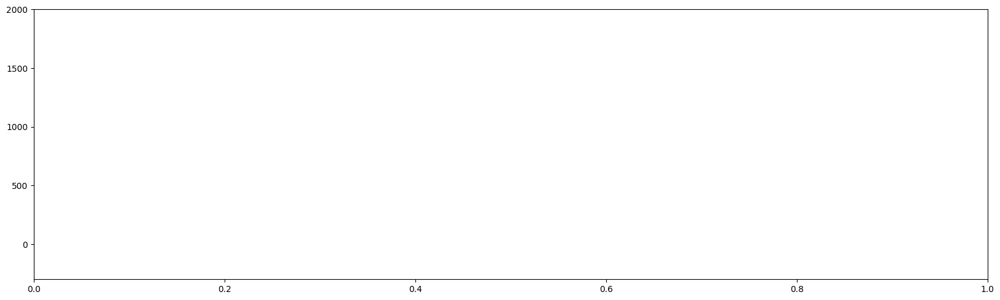

In [24]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 40]

print(ramcell_train_dataset.shape)
plt.subplot(6,1,1)
plt.ylim(-300,2000)
for i in range(100):
    plt.plot(ramcell_wavenum,ramcell_ecoli_dataset[i],label='ecoli_'+str(i),linewidth=1)
#plt.legend()

plt.subplot(6,1,2)
plt.ylim(-300,2000)
for i in range(100):
    plt.plot(ramcell_wavenum,ramcell_SA_dataset[i],label='SA_'+str(i),linewidth=1)
#plt.legend()
    
plt.subplot(6,1,3)
#plt.ylim(-0.005,0.02)
for i in range(100):
    plt.plot(ramcell_wavenum,ramcell_mix6_dataset[i],label='mix6_'+str(i),linewidth=1)
#plt.legend()
    
plt.subplot(6,1,4)
#plt.ylim(-0.005,0.02)
for i in range(100):
    plt.plot(ramcell_wavenum,ramcell_mix8_dataset[i],label='mix8_'+str(i),linewidth=1)
#plt.legend()
    
plt.subplot(6,1,5)
#plt.ylim(-150,1300)
plt.plot(ramcell_ecoli_wavenum,avg(ramcell_ecoli_dataset,0,538,1015),label='ecoli_adv',linewidth=1)
plt.plot(ramcell_SA_wavenum,avg(ramcell_SA_dataset,0,224,1015),label='SA_adv',linewidth=1)
plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset,0,1000,1015),label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,avg(ramcell_mix8_dataset,0,1058,1015),label='mix8_adv',linewidth=1)
plt.legend()

plt.subplot(6,1,6)
plt.ylim(-150,1300)
plt.plot(ramcell_ecoli_wavenum,avg(ramcell_ecoli_dataset,0,538,1015),label='ecoli_adv',linewidth=1)
plt.plot(ramcell_SA_wavenum,avg(ramcell_SA_dataset,0,224,1015),label='SA_adv',linewidth=1)
plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset,0,1000,1015),label='mix6_adv',linewidth=1)
#plt.plot(ramcell_mix8_wavenum,avg(ramcell_mix8_dataset,0,1058,1015),label='mix8_adv',linewidth=1)
plt.legend()

In [ ]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 40]


ramcell_ecoli_dataset_processed =postprocessing(ramcell_ecoli_dataset)
ramcell_SA_dataset_processed=postprocessing(ramcell_SA_dataset)
ramcell_mix6_dataset_processed=postprocessing(ramcell_mix6_dataset)
ramcell_mix8_dataset_processed=postprocessing(ramcell_mix8_dataset)

print(ramcell_ecoli_dataset_processed.shape)
print(ramcell_SA_dataset_processed.shape)
print(ramcell_mix6_dataset_processed.shape)
print(ramcell_mix8_dataset_processed.shape)

plt.subplot(7,1,1)
plt.ylim(-0.005,0.01)
for i in range(100):
    plt.plot(ramcell_ecoli_wavenum,ramcell_ecoli_dataset_processed[i],label='ecoli_'+str(i),linewidth=1)
#plt.legend()

plt.subplot(7,1,2)
plt.ylim(-0.005,0.01)
for i in range(100):
    plt.plot(ramcell_SA_wavenum,ramcell_SA_dataset_processed[i],label='SA_'+str(i),linewidth=1)
#plt.legend()
    
plt.subplot(7,1,3)
plt.ylim(-0.005,0.01)
for i in range(10):
    plt.plot(ramcell_mix6_wavenum,ramcell_mix6_dataset_processed[i],label='mix6_'+str(i),linewidth=1)
plt.legend()
    
plt.subplot(7,1,4)
plt.ylim(-0.005,0.01)
for i in range(10):
    plt.plot(ramcell_mix8_wavenum,ramcell_mix8_dataset_processed[i],label='mix8_'+str(i),linewidth=1)
plt.legend()
    
plt.subplot(7,1,5)
plt.ylim(-0.005,0.01)
plt.plot(ramcell_ecoli_wavenum,avg(ramcell_ecoli_dataset_processed,0,538,1015),label='ecoli_adv',linewidth=1)
#plt.plot(ramcell_SA_wavenum,avg(ramcell_SA_dataset_processed,0,224,1015),label='SA_adv',linewidth=1)
#plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset_processed,0,636,1015),label='mix6_adv',linewidth=1)
#plt.plot(ramcell_mix8_wavenum,avg(ramcell_mix8_dataset_processed,0,549,1015),label='mix8_adv',linewidth=1)
plt.legend()

plt.subplot(7,1,6)
plt.ylim(-0.005,0.01)
#plt.plot(ramcell_ecoli_wavenum,avg(ramcell_ecoli_dataset_processed,0,538,1015),label='ecoli_adv',linewidth=1)
plt.plot(ramcell_SA_wavenum,avg(ramcell_SA_dataset_processed,0,224,1015),label='SA_adv',linewidth=1)
#plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset_processed,0,636,1015),label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,avg(ramcell_mix8_dataset_processed,0,549,1015),label='mix8_adv',linewidth=1)
plt.legend()


plt.subplot(7,1,7)
#plt.ylim(-0.005,0.01)
#plt.plot(ramcell_ecoli_wavenum,std(ramcell_ecoli_dataset_processed,avg(ramcell_ecoli_dataset_processed,0,538,1015),0,538,1015),label='ecoli_adv',linewidth=1)
#plt.plot(ramcell_SA_wavenum,std(ramcell_SA_dataset_processed,avg(ramcell_SA_dataset_processed,0,224,1015),0,224,1015),label='SA_adv',linewidth=1)
#plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset_processed,0,636,1015),label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,std(ramcell_mix8_dataset_processed,avg(ramcell_mix8_dataset_processed,0,549,1015),0,549,1015),label='mix8_adv',linewidth=1)
plt.legend()

NameError: name 'ramcell_ecoli_dataset_processed' is not defined

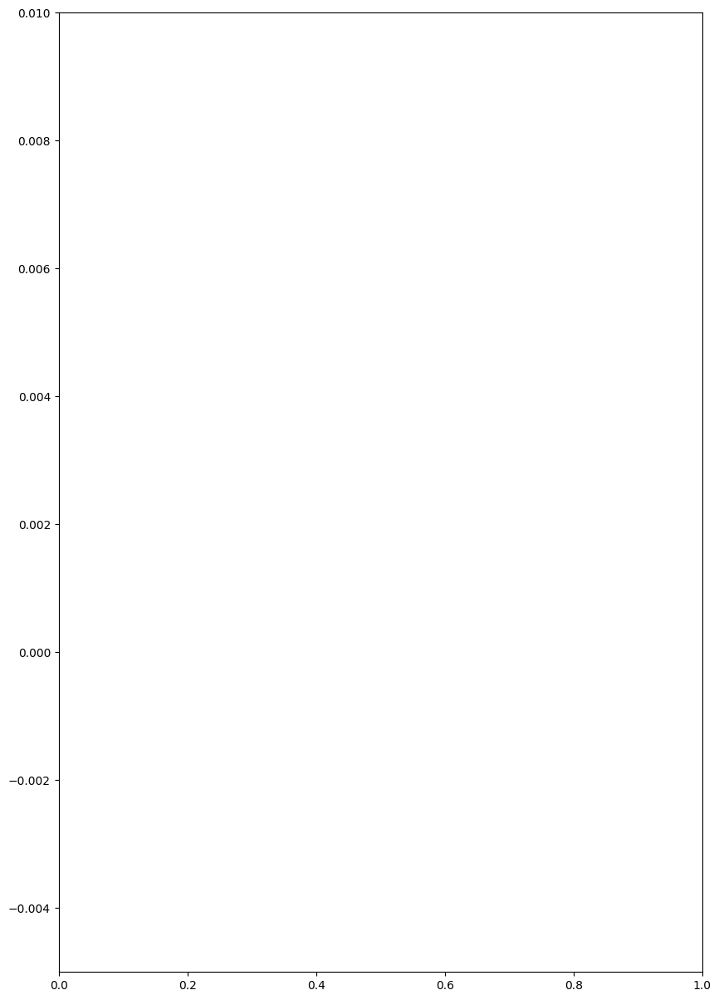

In [28]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [10, 15]
plt.ylim(-0.005,0.01)
plt.plot(ramcell_ecoli_wavenum,avg(ramcell_ecoli_dataset_processed,0,538,1015),label='ecoli_adv',linewidth=1)
plt.plot(ramcell_SA_wavenum,avg(ramcell_SA_dataset_processed,0,224,1015),label='SA_adv',linewidth=1)
plt.plot(ramcell_mix6_wavenum,avg(ramcell_mix6_dataset_processed,0,636,1015),label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,avg(ramcell_mix8_dataset_processed,0,549,1015),label='mix8_adv',linewidth=1)
plt.legend()


In [27]:
ramcell_ecoli_dataset_processed =postprocessing(ramcell_ecoli_dataset)
ramcell_SA_dataset_processed=postprocessing(ramcell_SA_dataset)
ramcell_mix6_dataset_processed=postprocessing(ramcell_mix6_dataset)
ramcell_mix8_dataset_processed=postprocessing(ramcell_mix8_dataset)

/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3441: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/jeonggyu/venv_dir/py37/lib/python3.7/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


In [23]:
%matplotlib inline
plt.rcParams['figure.figsize'] = [20, 40]
print(ramcell_ecoli_dataset_processed.shape)
print(ramcell_SA_dataset_processed.shape)
print(ramcell_mix6_dataset_processed.shape)
print(ramcell_mix8_dataset_processed.shape)

plt.subplot(8,1,1)
plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(ramcell_ecoli_wavenum,ramcell_ecoli_dataset_processed[i],label='ecoli_'+str(i),linewidth=1)
#plt.legend()
plt.title('pure e. coli (#100)')

plt.subplot(8,1,2)
plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(ramcell_SA_wavenum,ramcell_SA_dataset_processed[i],label='SA_'+str(i),linewidth=1)
#plt.legend()
plt.title('pure s. aureus (#100)')
    
plt.subplot(8,1,3)
plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(ramcell_mix6_wavenum,ramcell_mix6_dataset_processed[i],label='mix6_'+str(i),linewidth=1)
#plt.legend()
plt.title('mix6 1019 (#100)')
    
plt.subplot(8,1,4)
plt.ylim(-0.005,1.1)
for i in range(100):
    plt.plot(ramcell_mix8_wavenum,ramcell_mix8_dataset_processed[i],label='mix8_'+str(i),linewidth=1)
#plt.legend()
plt.title('mix8 1020 (#100)')
    
    
avg_ecoli = avg(ramcell_ecoli_dataset_processed,0,ramcell_ecoli_dataset_processed.shape[0],1015)
avg_sa = avg(ramcell_SA_dataset_processed,0,ramcell_SA_dataset_processed.shape[0],1015)
avg_mix6 = avg(ramcell_mix6_dataset_processed,0,ramcell_mix6_dataset_processed.shape[0],1015)
avg_mix8 = avg(ramcell_mix8_dataset_processed,0,ramcell_mix8_dataset_processed.shape[0],1015)

plt.subplot(8,1,5)
plt.ylim(-0.005,1.1)
plt.plot(ramcell_ecoli_wavenum,avg_ecoli,label='ecoli_adv',linewidth=1)
plt.plot(ramcell_SA_wavenum,avg_sa,label='SA_adv',linewidth=1)
plt.plot(ramcell_mix6_wavenum,avg_mix6,label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,avg_mix8,label='mix8_adv',linewidth=1)
plt.legend()
plt.title('average')

plt.subplot(8,1,6)
plt.ylim(-0.005,1.1)
#plt.plot(ramcell_ecoli_wavenum,avg_ecoli,label='ecoli_adv',linewidth=1)
#plt.plot(ramcell_SA_wavenum,avg_sa,label='SA_adv',linewidth=1)
plt.plot(ramcell_mix6_wavenum,avg_mix6,label='mix6_adv',linewidth=1)
plt.plot(ramcell_mix8_wavenum,avg_mix8,label='mix8_adv',linewidth=1)
plt.legend()
plt.title('average')


plt.subplot(8,1,7)
plt.plot(ramcell_ecoli_wavenum,std(ramcell_ecoli_dataset_processed,avg_ecoli,0,ramcell_ecoli_dataset_processed.shape[0],1015),label='ecoli_std',linewidth=1)
plt.plot(ramcell_SA_wavenum,std(ramcell_SA_dataset_processed,avg_sa,0,ramcell_SA_dataset_processed.shape[0],1015),label='SA_std',linewidth=1)
plt.plot(ramcell_mix6_wavenum,std(ramcell_mix6_dataset_processed,avg_mix6,0,ramcell_mix6_dataset_processed.shape[0],1015),label='mix6_std',linewidth=1)
plt.plot(ramcell_mix8_wavenum,std(ramcell_mix8_dataset_processed,avg_mix8,0,ramcell_mix8_dataset_processed.shape[0],1015),label='mix8_std',linewidth=1)
plt.legend()
plt.title('std')

plt.subplot(8,1,8)
plt.plot(ramcell_ecoli_wavenum,std(ramcell_ecoli_dataset_processed,avg_ecoli,0,ramcell_ecoli_dataset_processed.shape[0],1015),label='ecoli_std',linewidth=1)
plt.plot(ramcell_SA_wavenum,std(ramcell_SA_dataset_processed,avg_sa,0,ramcell_SA_dataset_processed.shape[0],1015),label='SA_std',linewidth=1)
plt.plot(ramcell_mix6_wavenum,std(ramcell_mix6_dataset_processed,avg_mix6,0,ramcell_mix6_dataset_processed.shape[0],1015),label='mix6_std',linewidth=1)
plt.plot(ramcell_mix8_wavenum,std(ramcell_mix8_dataset_processed,avg_mix8,0,ramcell_mix8_dataset_processed.shape[0],1015),label='mix8_std',linewidth=1)
plt.legend()
plt.title('std')

NameError: name 'ramcell_ecoli_dataset_processed' is not defined

In [31]:
np.where(ramcell_mix8_wavenum>1550)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119]),)

In [34]:
up_list=[]
down_list=[]
for i in range(ramcell_mix8_dataset_processed.shape[0]):
    if ramcell_mix8_dataset_processed[i][:120].mean() > avg_mix8[:120].mean():
        up_list.append(i)
    else :
        down_list.append(i)
print(len(up_list))
print(len(down_list))


456
602


In [35]:
ramcell_mix8_dataset_processed.shape[0]

1058

In [ ]:
3174
2539
2697

In [ ]:
3174*8/10

In [ ]:
3174/20+2539